# CA2 Strategic Thinking

Report by:  <font color=blue> Bobbi McDermott, Leandro Marigo, Ade, David Massey 
   

Lecturer: <font color=blue> James Garza
    
Date: <font color=blue> May 2023

## Licence

CC0 1.0 Universal (CC0 1.0)
Public Domain Dedication

The person who associated a work with this deed has dedicated the work to the public domain by waiving all of his or her rights to the work worldwide under copyright law, including all related and neighboring rights, to the extent allowed by law.

You can copy, modify, distribute and perform the work, even for commercial purposes, all without asking permission.

## 1. Business Understanding

### Introduction 

**Problem Statement**

Customer Personality Analysis is a detailed analysis of a company’s ideal customers. It helps a business to better understand its customers and makes it easier for them to modify products according to the specific needs, behaviors and concerns of different types of customers.

Customer personality analysis helps a business to modify its product based on its target customers from different types of customer segments. For example, instead of spending money to market a new product to every customer in the company’s database, a company can analyze which customer segment is most likely to buy the product and then market the product only on that particular segment  

    
**Attributes**
    

<font color = blue>People   

ID: Customer's unique identifier
Year_Birth: Customer's birth year
Education: Customer's education level
Marital_Status: Customer's marital status
Income: Customer's yearly household income
Kidhome: Number of children in customer's household
Teenhome: Number of teenagers in customer's household
Dt_Customer: Date of customer's enrollment with the company
Recency: Number of days since customer's last purchase
Complain: 1 if the customer complained in the last 2 years, 0 otherwise

<font color = blue>Products  

MntWines: Amount spent on wine in last 2 years
MntFruits: Amount spent on fruits in last 2 years
MntMeatProducts: Amount spent on meat in last 2 years
MntFishProducts: Amount spent on fish in last 2 years
MntSweetProducts: Amount spent on sweets in last 2 years
MntGoldProds: Amount spent on gold in last 2 years

<font color = blue>Promotion  

NumDealsPurchases: Number of purchases made with a discount
AcceptedCmp1: 1 if customer accepted the offer in the 1st campaign, 0 otherwise
AcceptedCmp2: 1 if customer accepted the offer in the 2nd campaign, 0 otherwise
AcceptedCmp3: 1 if customer accepted the offer in the 3rd campaign, 0 otherwise
AcceptedCmp4: 1 if customer accepted the offer in the 4th campaign, 0 otherwise
AcceptedCmp5: 1 if customer accepted the offer in the 5th campaign, 0 otherwise
Response: 1 if customer accepted the offer in the last campaign, 0 otherwise
Place

NumWebPurchases: Number of purchases made through the company’s website
NumCatalogPurchases: Number of purchases made using a catalogue
NumStorePurchases: Number of purchases made directly in stores
NumWebVisitsMonth: Number of visits to company’s website in the last month
Target
Need to perform clustering to summarize customer segments  

**Acknowledgement**  
    
The dataset for this project is provided by Dr. Omar Romero-Hernandez.



# Project Approach

![Crisp%20DM.png]()

## 2. Data Understanding

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns 
import plotly.graph_objs as go
%matplotlib inline

import plotly.express as px
from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics import homogeneity_completeness_v_measure, adjusted_rand_score

In [2]:
import warnings
warnings.filterwarnings('ignore') 

In [3]:
# reads the data from the file - denotes as CSV, it has no header, sets column headers
df = pd.read_csv("marketing_campaign.csv", sep='\t')

In [4]:
# show the top 5 rows
df.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,04-09-2012,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,08-03-2014,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,21-08-2013,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,10-02-2014,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,19-01-2014,94,173,...,5,0,0,0,0,0,0,3,11,0


**The dataset was tabulated within one column in the csv file so we separated it when reading it into the notebook**

In [5]:
# Get the number of observations and the names and data types of the columns
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2240 non-null   int64  
 1   Year_Birth           2240 non-null   int64  
 2   Education            2240 non-null   object 
 3   Marital_Status       2240 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2240 non-null   int64  
 6   Teenhome             2240 non-null   int64  
 7   Dt_Customer          2240 non-null   object 
 8   Recency              2240 non-null   int64  
 9   MntWines             2240 non-null   int64  
 10  MntFruits            2240 non-null   int64  
 11  MntMeatProducts      2240 non-null   int64  
 12  MntFishProducts      2240 non-null   int64  
 13  MntSweetProducts     2240 non-null   int64  
 14  MntGoldProds         2240 non-null   int64  
 15  NumDealsPurchases    2240 non-null   i

In [6]:
# Get the size of the data set
df.shape

(2240, 29)

In [7]:
# show descriptive statistics
df.describe()

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
count,2240.000000,2240.000000,2216.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,...,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.0,2240.0,2240.000000
mean,5592.159821,1968.805804,52247.251354,0.444196,0.506250,49.109375,303.935714,26.302232,166.950000,37.525446,...,5.316518,0.072768,0.074554,0.072768,0.064286,0.013393,0.009375,3.0,11.0,0.149107
std,3246.662198,11.984069,25173.076661,0.538398,0.544538,28.962453,336.597393,39.773434,225.715373,54.628979,...,2.426645,0.259813,0.262728,0.259813,0.245316,0.114976,0.096391,0.0,0.0,0.356274
min,0.000000,1893.000000,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
25%,2828.250000,1959.000000,35303.000000,0.000000,0.000000,24.000000,23.750000,1.000000,16.000000,3.000000,...,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
50%,5458.500000,1970.000000,51381.500000,0.000000,0.000000,49.000000,173.500000,8.000000,67.000000,12.000000,...,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
75%,8427.750000,1977.000000,68522.000000,1.000000,1.000000,74.000000,504.250000,33.000000,232.000000,50.000000,...,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
max,11191.000000,1996.000000,666666.000000,2.000000,2.000000,99.000000,1493.000000,199.000000,1725.000000,259.000000,...,20.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,3.0,11.0,1.000000


In [8]:
# show non-numeric statistics
df.describe(include=object)

,Education,Marital_Status,Dt_Customer
count,2240,2240,2240
unique,5,8,663
top,Graduation,Married,31-08-2012
freq,1127,864,12


In [9]:
# show columns
df.columns

Index(['ID', 'Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Dt_Customer', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Z_CostContact', 'Z_Revenue', 'Response'],
      dtype='object')

## 3. Data Preperation

### 3.1. Exploratory Data Analysis (EDA)

In [10]:
#!pip install dataprep

  0%|          | 0/1523 [00:00<?, ?it/s]


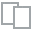
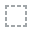
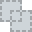
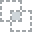
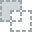
...
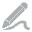
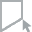
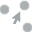
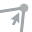
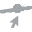

In [11]:
from dataprep.eda import plot, plot_correlation, create_report, plot_missing
plot(df)

**Now we can look at null values**

In [12]:
# number of missing values per column
df.isnull().sum()

ID                      0
Year_Birth              0
Education               0
Marital_Status          0
Income                 24
Kidhome                 0
Teenhome                0
Dt_Customer             0
Recency                 0
MntWines                0
MntFruits               0
MntMeatProducts         0
MntFishProducts         0
MntSweetProducts        0
MntGoldProds            0
NumDealsPurchases       0
NumWebPurchases         0
NumCatalogPurchases     0
NumStorePurchases       0
NumWebVisitsMonth       0
AcceptedCmp3            0
AcceptedCmp4            0
AcceptedCmp5            0
AcceptedCmp1            0
AcceptedCmp2            0
Complain                0
Z_CostContact           0
Z_Revenue               0
Response                0
dtype: int64

**There are 24 in 'Income' which we will have to view the distribution and frequency in order to access how to deal with these**

**Before addressing the Null values in 'Income' we need to view the unique values of the categorical columns**

In [13]:
# Displays total number of unique values 
df["Marital_Status"].unique()

array(['Single', 'Together', 'Married', 'Divorced', 'Widow', 'Alone',
       'Absurd', 'YOLO'], dtype=object)

**Can see here there are two values that have no context and will have to replace them with NaN**

In [14]:
# Displays total number of unique values 
df["Education"].unique()

array(['Graduation', 'PhD', 'Master', 'Basic', '2n Cycle'], dtype=object)

**All values in 'Education' have context so they will not need to be touched**

## Observations of EDA

**Dataprep.eda**  provides a broad overview for Exploratory Data Analysis  

- We can see immediately the distribution of all the Features to give an insight to how approach cleaning and Feature Selection

**Describe, shape and info**   shows an overall structure of the dataset

 - 'Education' and 'Marital Status' have categorical values that we will encode in order to get a numerical dataset  
 
**'Dt_Customer'**  is in a format that will need to be converted

- it is logical to convert it to a similar format as 'Year_Birth' for consitency  

**Marital_Status** contains unrecognizable values so we will convert them to Null 


**We will drop** the following columns as they do not hold information pertaining to our business plan

Campaign Marketting  

Complain  

Z_CostContract  

Z_Revenue  

Response 



### 3.2. Data Cleaning 

In [15]:
# drop unnecessary columns
df = df.drop(["AcceptedCmp3","AcceptedCmp4","AcceptedCmp5","AcceptedCmp1","AcceptedCmp2","Complain", 
              "Z_CostContact", "Z_Revenue", "Response"], axis = 1) 

**Dropped Campaign Marketting, Compain, Z_CostContact, Z_Revenue, Response**

In [16]:
# remove abstract naming values
incorrect_indicators = ["Absurd","YOLO", np.nan] 
    
df = df.replace(incorrect_indicators,np.nan)

**Here we replaced the values with no context with NaN value**  
**Now we can view our new NaN values within the Dataset and have a look at the unique values in 'Marital_Status' to make sure it's clean**

In [17]:
# show unique values
df["Marital_Status"].unique()

array(['Single', 'Together', 'Married', 'Divorced', 'Widow', 'Alone', nan],
      dtype=object)

In [18]:
df.isnull().sum()

ID                      0
Year_Birth              0
Education               0
Marital_Status          4
Income                 24
Kidhome                 0
Teenhome                0
Dt_Customer             0
Recency                 0
MntWines                0
MntFruits               0
MntMeatProducts         0
MntFishProducts         0
MntSweetProducts        0
MntGoldProds            0
NumDealsPurchases       0
NumWebPurchases         0
NumCatalogPurchases     0
NumStorePurchases       0
NumWebVisitsMonth       0
dtype: int64

**Can see now there are 4 null values in Marital Status and 24 null values in Income**

**We can drop rows with NaN values in 'Marital_Status'**

In [19]:
# drop 'Marital_Status'
df = df.dropna(axis=0, subset=['Marital_Status'])

In [20]:
# check info of dataframe again.
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2236 entries, 0 to 2239
Data columns (total 20 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2236 non-null   int64  
 1   Year_Birth           2236 non-null   int64  
 2   Education            2236 non-null   object 
 3   Marital_Status       2236 non-null   object 
 4   Income               2212 non-null   float64
 5   Kidhome              2236 non-null   int64  
 6   Teenhome             2236 non-null   int64  
 7   Dt_Customer          2236 non-null   object 
 8   Recency              2236 non-null   int64  
 9   MntWines             2236 non-null   int64  
 10  MntFruits            2236 non-null   int64  
 11  MntMeatProducts      2236 non-null   int64  
 12  MntFishProducts      2236 non-null   int64  
 13  MntSweetProducts     2236 non-null   int64  
 14  MntGoldProds         2236 non-null   int64  
 15  NumDealsPurchases    2236 non-null   i

In [21]:
df.isnull().sum()

ID                      0
Year_Birth              0
Education               0
Marital_Status          0
Income                 24
Kidhome                 0
Teenhome                0
Dt_Customer             0
Recency                 0
MntWines                0
MntFruits               0
MntMeatProducts         0
MntFishProducts         0
MntSweetProducts        0
MntGoldProds            0
NumDealsPurchases       0
NumWebPurchases         0
NumCatalogPurchases     0
NumStorePurchases       0
NumWebVisitsMonth       0
dtype: int64

**View distribution of missing values in 'Income' to decide on how to handle the missing values**

In [22]:
# View distribution of missing values in 'Income' to decide on how to handle the missing values
fig = px.histogram(df, x="Income", 
                   nbins=30, 
                   opacity=0.7, 
                   color_discrete_sequence=["#c70610"]
                   )
fig.update_layout(title="Income Distribution", 
                  xaxis_title="Income")
fig.show()

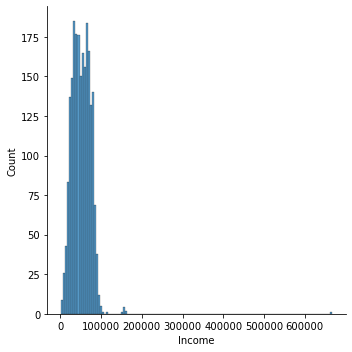

In [23]:
sns.displot(df["Income"])
plt.show()

In [24]:
# show skewness of data points
skew_vals = df.skew(axis=0, skipna=True, level=None, numeric_only=None)

fig = go.Figure(
    data=go.Bar(
        x=skew_vals.index,
        y=skew_vals.values,
        marker_color="mediumslateblue"
    )
)

fig.update_layout(title="Skewness Values", xaxis_title="Column Name", yaxis_title="Skewness")
fig.show()

In [25]:
df.skew(axis=0, skipna=True, level=None, numeric_only=None)

ID                     0.039923
Year_Birth            -0.351844
Income                 6.765274
Kidhome                0.632458
Teenhome               0.407663
Recency               -0.002304
MntWines               1.175452
MntFruits              2.106715
MntMeatProducts        2.084244
MntFishProducts        1.924064
MntSweetProducts       2.135444
MntGoldProds           1.886944
NumDealsPurchases      2.424613
NumWebPurchases        1.384989
NumCatalogPurchases    1.884662
NumStorePurchases      0.702418
NumWebVisitsMonth      0.209989
dtype: float64

As there are very few outliers under feature "Income" and the data is skewed (higher than 2), we have decied to replace missing values with the median value.  

https://vitalflux.com/pandas-impute-missing-values-mean-median-mode/  

And will drop the 4 missing values under feature "Marital_Status" as it represents only 1.8% of the dataset.  

According to William J. Montelpare, Ph.D., Emily Read, Ph.D., Teri McComber, Alyson Mahar, Ph.D., and Krista Ritchie, Ph.D., cited in their open book 'Applied Statistics in Healthcare Research' when considering dropping missing values, a good rule of thumb is to ensure data loss does not exceed 5%. Whilst carrying out EDA, analysts carrying out this piece of work, have ensured an even smaller loss of below <1% demonstrated with a simple calculation.

In [26]:
# replace the empty cells with NaN
df.Income.replace('',np.nan,regex = True)

0       58138.0
1       46344.0
2       71613.0
3       26646.0
4       58293.0
         ...   
2235    61223.0
2236    64014.0
2237    56981.0
2238    69245.0
2239    52869.0
Name: Income, Length: 2236, dtype: float64

In [27]:
# Replace Nan with the median Income value
df['Income'] = df['Income'].fillna(df['Income'].median())

In [28]:
# re-check null values to ensure they are gone.
df.isnull().sum()

ID                     0
Year_Birth             0
Education              0
Marital_Status         0
Income                 0
Kidhome                0
Teenhome               0
Dt_Customer            0
Recency                0
MntWines               0
MntFruits              0
MntMeatProducts        0
MntFishProducts        0
MntSweetProducts       0
MntGoldProds           0
NumDealsPurchases      0
NumWebPurchases        0
NumCatalogPurchases    0
NumStorePurchases      0
NumWebVisitsMonth      0
dtype: int64

**Create df for cohort analysis further on**

### 3.3. Feature Engineering

**In order to make the dataset consistent we will transform 'Dt_Customer' to the same format as 'Year_Birth' and transform to 'Consumer_Duration'**  

**It was also decided to calcuate the 'Age' from 'Year_Birth' and rename 'Recency with 'Time_Last_Visited as it is a better visualisation of customer profile**

**Create a 'Total_Spend' Column

In [29]:
df['Dt_Customer'] =  pd.to_datetime(df['Dt_Customer'], format= '%d-%m-%Y')

<cite> https://stackoverflow.com/questions/51898826/converting-object-column-in-pandas-dataframe-to-datetime

In [30]:
df['Dt_Customer'] = df['Dt_Customer'].dt.strftime('%Y')

<cite> https://stackoverflow.com/questions/48573937/how-to-remove-day-from-date-in-python

In [31]:
# re-checking the columns data types
df.dtypes

ID                       int64
Year_Birth               int64
Education               object
Marital_Status          object
Income                 float64
Kidhome                  int64
Teenhome                 int64
Dt_Customer             object
Recency                  int64
MntWines                 int64
MntFruits                int64
MntMeatProducts          int64
MntFishProducts          int64
MntSweetProducts         int64
MntGoldProds             int64
NumDealsPurchases        int64
NumWebPurchases          int64
NumCatalogPurchases      int64
NumStorePurchases        int64
NumWebVisitsMonth        int64
dtype: object

In [32]:
pd.to_datetime(df['Dt_Customer'], format= '%Y')

0      2012-01-01
1      2014-01-01
2      2013-01-01
3      2014-01-01
4      2014-01-01
          ...    
2235   2013-01-01
2236   2014-01-01
2237   2014-01-01
2238   2014-01-01
2239   2012-01-01
Name: Dt_Customer, Length: 2236, dtype: datetime64[ns]

**Now 'Dt_Customer' is in the correct format, we'll convert to an integer**

In [33]:
df['Dt_Customer'].astype(object).astype(int)

0       2012
1       2014
2       2013
3       2014
4       2014
        ... 
2235    2013
2236    2014
2237    2014
2238    2014
2239    2012
Name: Dt_Customer, Length: 2236, dtype: int32

**We'll now create a new column calculating the year difference between the last visit and the current date**  
**We'll then drop 'Dt_Customer'**  
**The same process will be used to covert 'Year_Birth' to 'Age'**  

In [34]:
from datetime import datetime, date
 
def time(spent):
    spent = datetime.strptime(spent, "%Y").date()
    today = date.today()
    return today.year - spent.year - ((today.month, 
                                      today.day) < (spent.month, 
                                                    spent.day))
  
df['Customer_Duration'] = df['Dt_Customer'].apply(time)
  
display(df)

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Customer_Duration
0,5524,1957,Graduation,Single,58138.0,0,0,2012,58,635,...,546,172,88,88,3,8,10,4,7,11
1,2174,1954,Graduation,Single,46344.0,1,1,2014,38,11,...,6,2,1,6,2,1,1,2,5,9
2,4141,1965,Graduation,Together,71613.0,0,0,2013,26,426,...,127,111,21,42,1,8,2,10,4,10
3,6182,1984,Graduation,Together,26646.0,1,0,2014,26,11,...,20,10,3,5,2,2,0,4,6,9
4,5324,1981,PhD,Married,58293.0,1,0,2014,94,173,...,118,46,27,15,5,5,3,6,5,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,10870,1967,Graduation,Married,61223.0,0,1,2013,46,709,...,182,42,118,247,2,9,3,4,5,10
2236,4001,1946,PhD,Together,64014.0,2,1,2014,56,406,...,30,0,0,8,7,8,2,5,7,9
2237,7270,1981,Graduation,Divorced,56981.0,0,0,2014,91,908,...,217,32,12,24,1,2,3,13,6,9
2238,8235,1956,Master,Together,69245.0,0,1,2014,8,428,...,214,80,30,61,2,6,5,10,3,9


In [35]:
# dropping column Dt_Customer and storing it in a new data frame
df2 = df.drop(['Dt_Customer'], axis=1)

In [36]:
# displaying first 5 rows of the new data frame
df2.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Customer_Duration
0,5524,1957,Graduation,Single,58138.0,0,0,58,635,88,546,172,88,88,3,8,10,4,7,11
1,2174,1954,Graduation,Single,46344.0,1,1,38,11,1,6,2,1,6,2,1,1,2,5,9
2,4141,1965,Graduation,Together,71613.0,0,0,26,426,49,127,111,21,42,1,8,2,10,4,10
3,6182,1984,Graduation,Together,26646.0,1,0,26,11,4,20,10,3,5,2,2,0,4,6,9
4,5324,1981,PhD,Married,58293.0,1,0,94,173,43,118,46,27,15,5,5,3,6,5,9


In [37]:
df2['Year_Birth'] =  pd.to_datetime(df2['Year_Birth'], format= '%Y')

In [38]:
df2['Year_Birth'] = df2['Year_Birth'].dt.strftime('%Y')

In [39]:
# creating age column based on 'Year_Birth', subtracting today's date
from datetime import datetime, date
 
def age(born):
    born = datetime.strptime(born, "%Y").date()
    today = date.today()
    return today.year - born.year - ((today.month, 
                                      today.day) < (born.month, 
                                                    born.day))
  
df2['Age'] = df2['Year_Birth'].apply(age)
  
display(df2)

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,...,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Customer_Duration,Age
0,5524,1957,Graduation,Single,58138.0,0,0,58,635,88,...,172,88,88,3,8,10,4,7,11,66
1,2174,1954,Graduation,Single,46344.0,1,1,38,11,1,...,2,1,6,2,1,1,2,5,9,69
2,4141,1965,Graduation,Together,71613.0,0,0,26,426,49,...,111,21,42,1,8,2,10,4,10,58
3,6182,1984,Graduation,Together,26646.0,1,0,26,11,4,...,10,3,5,2,2,0,4,6,9,39
4,5324,1981,PhD,Married,58293.0,1,0,94,173,43,...,46,27,15,5,5,3,6,5,9,42
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,10870,1967,Graduation,Married,61223.0,0,1,46,709,43,...,42,118,247,2,9,3,4,5,10,56
2236,4001,1946,PhD,Together,64014.0,2,1,56,406,0,...,0,0,8,7,8,2,5,7,9,77
2237,7270,1981,Graduation,Divorced,56981.0,0,0,91,908,48,...,32,12,24,1,2,3,13,6,9,42
2238,8235,1956,Master,Together,69245.0,0,1,8,428,30,...,80,30,61,2,6,5,10,3,9,67


In [40]:
# dropping column 'Year_Birth'
df=df2.drop(["Year_Birth"], axis=1)

In [41]:
# renaming column for convenience
df.rename(columns = {'Recency':'Time_Since_Last_Visit'}, inplace = True)

**Create a feature for total children in a household which will be the sum of the features "Kidhome" + "Teenhome"**

In [42]:
df['Total_Children'] = df['Kidhome'] + df['Teenhome']

In [43]:
# dropping 'Kidhome' and 'Teenhome'
df.drop(['Kidhome','Teenhome'], axis = 1)

,ID,Education,Marital_Status,Income,Time_Since_Last_Visit,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Customer_Duration,Age,Total_Children
0,5524,Graduation,Single,58138.0,58,635,88,546,172,88,88,3,8,10,4,7,11,66,0
1,2174,Graduation,Single,46344.0,38,11,1,6,2,1,6,2,1,1,2,5,9,69,2
2,4141,Graduation,Together,71613.0,26,426,49,127,111,21,42,1,8,2,10,4,10,58,0
3,6182,Graduation,Together,26646.0,26,11,4,20,10,3,5,2,2,0,4,6,9,39,1
4,5324,PhD,Married,58293.0,94,173,43,118,46,27,15,5,5,3,6,5,9,42,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,10870,Graduation,Married,61223.0,46,709,43,182,42,118,247,2,9,3,4,5,10,56,1
2236,4001,PhD,Together,64014.0,56,406,0,30,0,0,8,7,8,2,5,7,9,77,3
2237,7270,Graduation,Divorced,56981.0,91,908,48,217,32,12,24,1,2,3,13,6,9,42,0
2238,8235,Master,Together,69245.0,8,428,30,214,80,30,61,2,6,5,10,3,9,67,1


**Create 'Total_Spend' Column for items bought**

In [44]:
df["Total_Spend"]= df["MntWines"]+df["MntFruits"]+df["MntMeatProducts"]+df["MntFishProducts"]+df["MntSweetProducts"]+df["MntGoldProds"]

### 3.4. Data Visualisation 

In [45]:
# Create a histogram with 30 bins for the "Total_Spend" column of the df DataFrame
fig = px.histogram(df, x="Total_Spend", nbins=30, opacity=0.7, color_discrete_sequence=["#c70610"])
# Update the layout to add a title and axis labels
fig.update_layout(title="Total Spend Distribution", xaxis_title="Total Spend")
# Display the plot
fig.show()

In [46]:
# Create a box plot of the "Total_Spend" column
fig = go.Figure(data=go.Box(y=df["Total_Spend"], marker_color="mediumslateblue"))

# Update the layout to add a title and axis labels
fig.update_layout(title={'text': "Total Spend Box Plot",
        'x': 0.5, # set the title to the center of the plot
        'xanchor': 'center'}, yaxis_title="Total Spend", height=500, width=500)

# Display the plot
fig.show()

**Create bins classification for - 'High Spending Customers', 'Average Spending Customers' and 'Low Spending Customers'**

In [47]:
# Create bins classification for - 'High Spending Customers', 'Average Spending Customers' and 'Low Spending Customers'
df.loc[df['Total_Spend'].between(0, 68.75, 'both'), 'Cust_Profile'] = 'Low Spend'
df.loc[df['Total_Spend'].between(68.75, 1045.5, 'right'), 'Cust_Profile'] = 'Average Spend'
df.loc[df['Total_Spend'].between(1045.5, 3000, 'right'), 'Cust_Profile'] = 'High Spend'

In [48]:
# Get the top 40 customer spend profiles by count
top_profiles = df.Cust_Profile.value_counts().nlargest(40)

# Create a bar chart of the top customer spend profiles
fig = go.Figure(data=go.Bar(x=top_profiles.index, y=top_profiles.values, marker_color="lightseagreen"))

# Update the layout to add a title and axis labels
fig.update_layout(title={'text': "Number of Customers by Spend Profile",
        'x': 0.5, # set the title to the center of the plot
        'xanchor': 'center'}, xaxis_title="Spend Profile", yaxis_title="Number of Customers",
                 height=500, width=800)

# Display the plot
fig.show()

In [49]:
# describe the Age profile
df['Age'].describe()

count    2236.000000
mean       54.203488
std        11.980604
min        27.000000
25%        46.000000
50%        53.000000
75%        64.000000
max       130.000000
Name: Age, dtype: float64

In [50]:
# create new column for the Age Profile
df.loc[df['Age'].between(0, 30, 'both'), 'Age_Profile'] = 'Gen_Z'
df.loc[df['Age'].between(30, 55, 'right'), 'Age_Profile'] = 'Gen_Y'
df.loc[df['Age'].between(55, 129, 'right'), 'Age_Profile'] = 'Gen_X'

Age Profile description:  

    - Gen_Z = between 0 and 30 years old  
    - Gen_Y = between 31 and 55 years old  
    - Gen_X = between 56 and 129 years old (outliers in Age, older than 100 years, will be excluded later on)

In [51]:
{'text': "Number of Customers by Age Profile",
        'x': 0.5, # set the title to the center of the plot
        'xanchor': 'center'}

{'text': 'Number of Customers by Age Profile', 'x': 0.5, 'xanchor': 'center'}

In [52]:
# Get the top 40 customer age profiles by count
top_profiles = df.Age_Profile.value_counts().nlargest(40)

# Create a bar chart of the top customer age profiles
fig = go.Figure(data=go.Bar(x=top_profiles.index, y=top_profiles.values, marker_color="lightseagreen"))

# Update the layout to add a title and axis labels
fig.update_layout(title={'text': "Number of Customers by Age Profile",
        'x': 0.5, # set the title to the center of the plot
        'xanchor': 'center'}, xaxis_title="Age Profile", yaxis_title="Number of Customers",
                 height=500, width=800)

# Display the plot
fig.show()

**Finding Correlation among Features**

In [53]:
{'text': "Correlation Matrix",
        'x': 0.5, # set the title to the center of the plot
        'xanchor': 'center'}

{'text': 'Correlation Matrix', 'x': 0.5, 'xanchor': 'center'}

In [54]:
# Compute the correlation matrix
corr = df.corr()

# Create a lower triangular mask for the correlation matrix
mask = np.tril(np.ones_like(corr, dtype=np.bool))

# Create a heatmap trace of the correlation matrix
fig = go.Figure(data=go.Heatmap(
                   x=corr.columns,
                   y=corr.columns,
                   z=corr.values,
                   colorscale='RdBu_r',
                   zmin=-1,
                   zmax=1,
                   hoverongaps=False))

# Update the layout to add a title and axis labels
fig.update_layout(title={'text': "Correlation Matrix",
        'x': 0.5, # set the title to the center of the plot
        'xanchor': 'center'}, xaxis_title="Feature", yaxis_title="Feature",height=700, width=800)

# Show the plot
fig.show()

<AxesSubplot:>

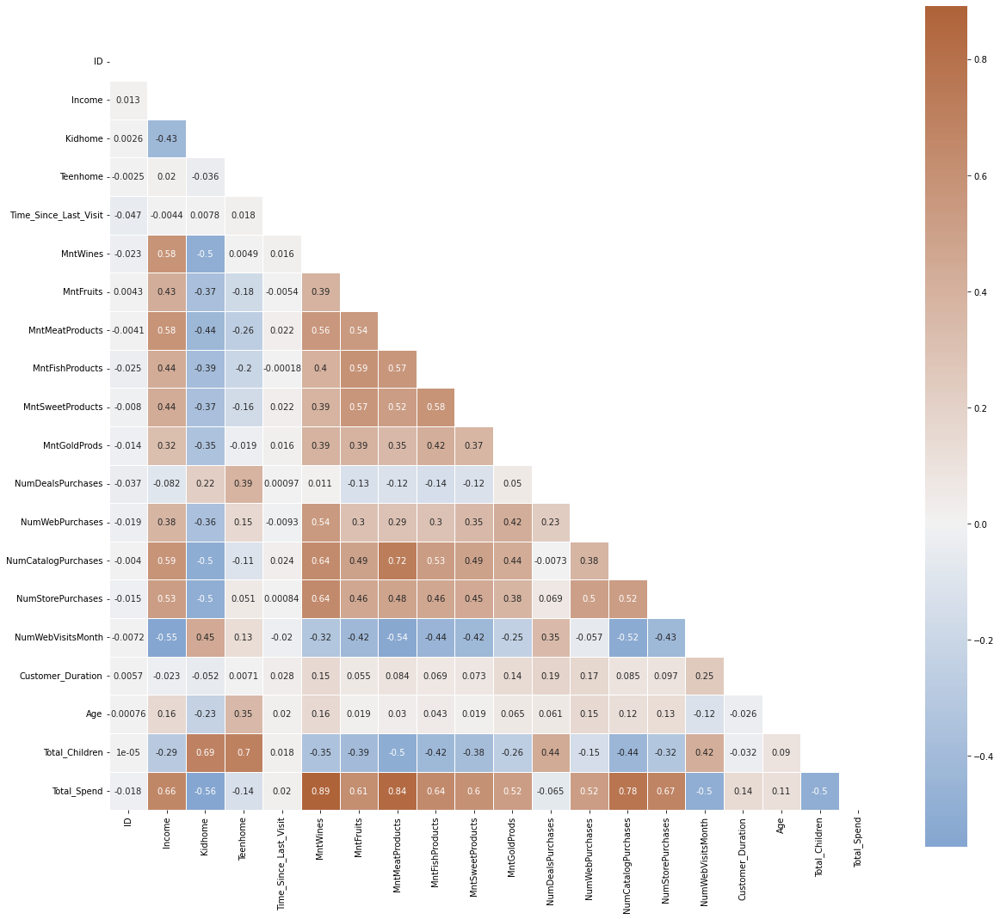

In [55]:
corr = df.corr()
mask = np.triu(np.ones_like(corr, dtype=np.bool))
f, ax = plt.subplots(figsize=(20, 20))
cmap = sns.diverging_palette(250, 30, as_cmap=True)
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=None, center=0,square=True, annot=True, linewidths=.5, cbar_kws={"shrink": .9})

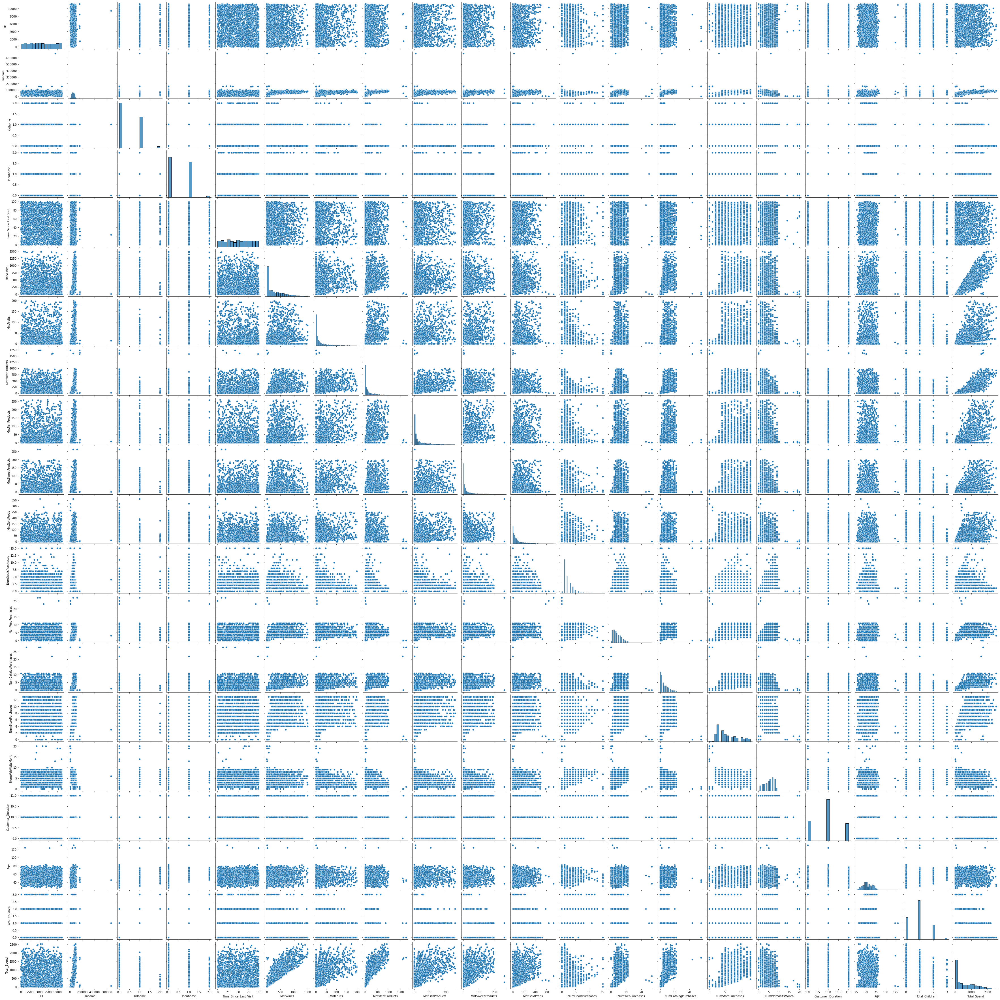

In [56]:
sns.pairplot(df)

### 3.5. Customer Profiling insights before ML models

We can see that total spend is highly correlated to the customers income and education level but not so much to the customers age group. We aim to find better correlation across the different customers profile and what they buy in order to establish the best strategy approach after applying the clustering and market basked analysis models.

For better visualization, the charts below for Income are excluding outliers.

In [57]:
# Create the scatterplot using Plotly
fig = px.scatter(df[df['Income']<600000], x='Total_Spend', y='Income', color='Cust_Profile')

# Update the layout to set the plot size and add axis labels
fig.update_layout(
    width=800,
    height=500,
    title={'text': "Total Spend vs. Income by Customer Profile",
        'x': 0.5, # set the title to the center of the plot
        'xanchor': 'center'},
    xaxis_title='Total Spend',
    yaxis_title='Income'
)

# Show the plot
fig.show()

In [58]:
{'text': "Income vs Total Spend by Age Profile",
        'x': 0.5, # set the title to the center of the plot
        'xanchor': 'center'}

{'text': 'Income vs Total Spend by Age Profile', 'x': 0.5, 'xanchor': 'center'}

In [59]:
# Filter the data to only include incomes less than 600,000 and non-null Age_Profile values
df_filtered = df[(df['Income'] < 600000) & df['Age_Profile'].notnull()]

# Create the scatter plot
fig = px.scatter(df_filtered, x='Total_Spend', y='Income', color='Age_Profile')

# Update the layout to add a title and axis labels
fig.update_layout(
    title={'text': "Income vs Total Spend by Age Profile",
        'x': 0.5, # set the title to the center of the plot
        'xanchor': 'center'},
    xaxis_title="Total Spend",
    yaxis_title="Income", height=600, width=900
)

# Display the plot
fig.show()

#### Age group insights

Most of our customers (58.1%) are classified under Gen Y = Age between 31 and 55. In average highest spenders are classified under Gen Z = Age between 56 and 82 - (max age excluding outliers).

In [60]:
# Define a list of colors for each age profile
colors = ['tomato' ,'mediumslateblue', 'lightseagreen']

# Create a dictionary with counts of each age profile
age_counts = df['Age_Profile'].value_counts().to_dict()

# Create a bar trace with x-axis as the age profile categories and y-axis as their counts,
# and set the color of each bar based on its index in the list of colors
bar = go.Bar(
    x=list(age_counts.keys()), 
    y=list(age_counts.values()), 
    marker_color=[colors[i % len(colors)] for i in range(len(age_counts))]
)

# Create a layout with a title and axis labels
layout = go.Layout(
    title={
        'text': "Age Profile Distribution",
        'x': 0.5,
        'xanchor': 'center'
    }, 
    xaxis=dict(title='Age Profile'), 
    yaxis=dict(title='Count'), 
    height=500, 
    width=700
)

# Create a figure with the bar trace and layout, and show the figure
fig = go.Figure(data=[bar], layout=layout)
fig.show()

<AxesSubplot:ylabel='Age_Profile'>

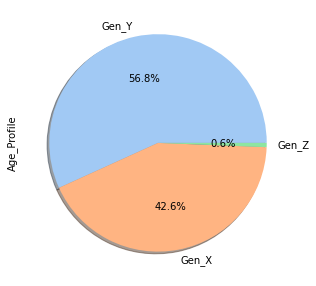

In [61]:
df['Age_Profile'].value_counts().plot.pie(autopct='%1.1f%%', shadow=True, figsize=(5,5), colors=sns.color_palette('pastel'))

In [62]:
spend_age = df.groupby('Age_Profile')['Total_Spend'].sum()
spend_age

Age_Profile
Gen_X    656336
Gen_Y    684341
Gen_Z     13056
Name: Total_Spend, dtype: int64

In [63]:
# Define a list of colors for each age profile
colors = ['mediumslateblue', 'tomato', 'lightseagreen']

# Create a bar plot trace with x-axis as Age Group and y-axis as Total Spend
bar = go.Bar(x=spend_age.index, y=spend_age, marker_color=[colors[i % len(colors)] for i in range(len(age_counts))])

# Create a layout with a title and axis labels
layout = go.Layout(title={
        'text': "Total Spend by Age Group",
        'x': 0.5,
        'xanchor': 'center'
    }, xaxis=dict(title='Age Group'), 
                   yaxis=dict(title='Total Spend'),height=500, width=700)

# Create a Figure object
fig = go.Figure(data=[bar], layout=layout)

# Show the plot
fig.show()

In [64]:
spend_age2 = df.groupby('Age_Profile')['Total_Spend'].mean()
spend_age2

Age_Profile
Gen_X    689.428571
Gen_Y    539.275808
Gen_Z    932.571429
Name: Total_Spend, dtype: float64

In [65]:
# Define a list of colors for each age profile
colors = ['mediumslateblue', 'tomato', 'lightseagreen']

# Create a bar chart trace with x-axis as Age_Group and y-axis as Average_Spend
bar = go.Bar(x=spend_age2.index, y=spend_age2.values, 
             marker_color=[colors[i % len(colors)] for i in range(len(age_counts))])

# Create a layout with a title and axis labels
layout = go.Layout(title={
        'text': "Average Spend by Age Group",
        'x': 0.5,
        'xanchor': 'center'
    }, xaxis=dict(title='Age Group'), 
                   yaxis=dict(title='Average Spend'),height=500, width=700)

# Create a Figure object and add the trace and layout
fig = go.Figure(data=[bar], layout=layout)

# Show the plot
fig.show()

#### Education level insights

Around 50% and most of our customers have only graduated. We can see in the graphs below the total spend by education level as well as the average spend by education level, which shows that highest spenders in average are customers with PHD.

In [66]:
# Count the number of customers in each education level
edu_counts = df['Education'].value_counts()

# Define the colors for each education level
color_dict = {'2n Cycle': 'rgb(171, 99, 250)',
              'Basic': 'rgb(230, 99, 250)',
              'Graduation': 'rgb(99, 110, 250)',
              'Master': 'rgb(25, 211, 243)',
              'PhD': 'rgb(50, 255, 126)'}

# Create a bar trace with x-axis as education level and y-axis as customer count
bar = go.Bar(x=edu_counts.index, y=edu_counts.values, 
             marker=dict(color=[color_dict[x] for x in edu_counts.index]))

# Create a layout with a title and axis labels
layout = go.Layout(title={
        'text': "Customer Education Distribution",
        'x': 0.5,
        'xanchor': 'center'
    }, xaxis=dict(title='Education Level'), 
                   yaxis=dict(title='Number of Customers'),height=500, width=700)

# Create a figure with the bar trace and layout
fig = go.Figure(data=[bar], layout=layout)

# Display the figure
fig.show()

<AxesSubplot:ylabel='Education'>

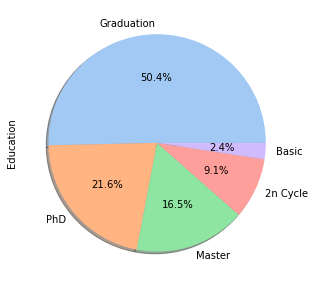

In [67]:
df['Education'].value_counts().plot.pie(autopct='%1.1f%%', shadow=True, figsize=(5,5), colors=sns.color_palette('pastel'))

In [68]:
spend_education = df.groupby('Education')['Total_Spend'].sum()
spend_education

Education
2n Cycle      100795
Basic           4417
Graduation    697410
Master        225190
PhD           325943
Name: Total_Spend, dtype: int64

In [69]:
# Get the total spend by education level
TS_counts = df.groupby('Education')['Total_Spend'].sum()

# Define a dictionary mapping education level to color
color_dict = {'2n Cycle': 'rgb(171, 99, 250)',
              'Basic': 'rgb(230, 99, 250)',
              'Graduation': 'rgb(99, 110, 250)',
              'Master': 'rgb(25, 211, 243)',
              'PhD': 'rgb(50, 255, 126)'}

# Filter the color_dict to only include keys present in TS_counts.index
color_dict = {k:v for k,v in color_dict.items() if k in TS_counts.index}

# Create a bar trace with x-axis as education level and y-axis as customer count
bar = go.Bar(x=TS_counts.index, y=TS_counts.values, 
             marker=dict(color=[color_dict[x] for x in TS_counts.index]))

# Create a layout with a title and axis labels
layout = go.Layout(title={
        'text': "Total Spend by Education",
        'x': 0.5,
        'xanchor': 'center'
    }, xaxis=dict(title='Education Level'), 
                   yaxis=dict(title='Total Spend'),height=500, width=700)

# Create a Figure object and plot the bar chart
fig = go.Figure(data=[bar], layout=layout)
fig.show()

In [70]:
spend_education2 = df.groupby('Education')['Total_Spend'].mean()
spend_education2

Education
2n Cycle      496.527094
Basic          81.796296
Graduation    619.369449
Master        610.271003
PhD           673.435950
Name: Total_Spend, dtype: float64

In [71]:
# Define a dictionary of colors for each education level
color_dict = {'2n Cycle': 'rgb(171, 99, 250)',
              'Basic': 'rgb(230, 99, 250)',
              'Graduation': 'rgb(99, 110, 250)',
              'Master': 'rgb(25, 211, 243)',
              'PhD': 'rgb(50, 255, 126)'}

# Create a bar trace with x-axis as education level and y-axis as average spend
bar = go.Bar(x=spend_education2.index, y=spend_education2.values, 
             marker=dict(color=[color_dict[x] for x in spend_education2.index]))

# Create a layout with a title and axis labels
layout = go.Layout(title={
        'text': "Average Spend by Education",
        'x': 0.5,
        'xanchor': 'center'
    }, xaxis=dict(title='Education Level'), 
                   yaxis=dict(title='Average Spend'),height=500, width=700)

# Create a Figure object and add the bar trace and layout
fig = go.Figure(data=[bar], layout=layout)

# Show the plot
fig.show()

#### Marital status insights

Most of our customers (38.6%) are Married. In average highest spenders are widow customers.

In [72]:
# Calculate the customer count by marital status
MS_counts = df['Marital_Status'].value_counts()

# Define color codes for each marital status category
color_dict = {'Alone': 'rgb(99, 99, 250)',
              'Divorced': 'rgb(171, 99, 250)',
              'Married': 'rgb(230, 99, 250)',
              'Single': 'rgb(99, 110, 250)',
              'Together': 'rgb(25, 211, 243)',
              'Widow': 'rgb(50, 255, 126)'}

# Create a bar trace with x-axis as marital status and y-axis as customer count
bar = go.Bar(x=MS_counts.index, y=MS_counts.values, 
             marker=dict(color=[color_dict[x] for x in MS_counts.index]))

# Create a layout with a title and axis labels
layout = go.Layout(title={
        'text': "Customer Count by Marital Status",
        'x': 0.5,
        'xanchor': 'center'
    }, xaxis=dict(title='Marital Status'), 
                   yaxis=dict(title='Customer Count'),height=500, width=700)

# Create a figure object and plot the bar chart
fig = go.Figure(data=[bar], layout=layout)
fig.show()

<AxesSubplot:ylabel='Marital_Status'>

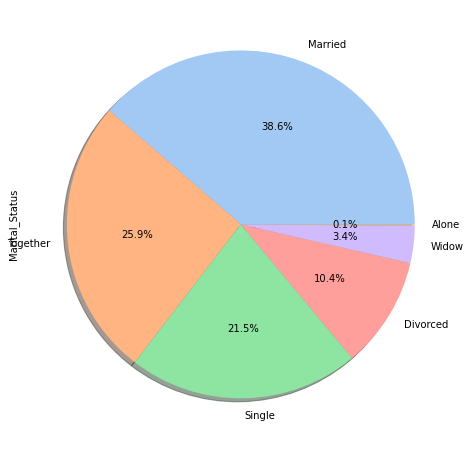

In [73]:
df['Marital_Status'].value_counts().plot.pie(autopct='%1.1f%%', shadow=True, figsize=(8,8), colors=sns.color_palette('pastel'))

In [74]:
spend_MaritalStatus = df.groupby('Marital_Status')['Total_Spend'].sum()
spend_MaritalStatus

Marital_Status
Alone          770
Divorced    141666
Married     510453
Single      291112
Together    352865
Widow        56889
Name: Total_Spend, dtype: int64

In [75]:
# Calculate total spend by marital status
TS_MaritalStatus = df.groupby('Marital_Status')['Total_Spend'].sum()

# Define color codes for each marital status category
color_dict = {'Alone': 'rgb(99, 99, 250)',
              'Divorced': 'rgb(171, 99, 250)',
              'Married': 'rgb(230, 99, 250)',
              'Single': 'rgb(99, 110, 250)',
              'Together': 'rgb(25, 211, 243)',
              'Widow': 'rgb(50, 255, 126)'}

# Create a bar trace with x-axis as marital status and y-axis as total spend
bar = go.Bar(x=TS_MaritalStatus.index, y=TS_MaritalStatus.values, 
             marker=dict(color=[color_dict[x] for x in TS_MaritalStatus.index]))

# Create a layout with a title and axis labels
layout = go.Layout(title={
        'text': "Total Spend by Marital Status",
        'x': 0.5,
        'xanchor': 'center'
    }, xaxis=dict(title='Marital Status'), 
                   yaxis=dict(title='Total Spend'),height=500, width=700)

# Create a figure object and plot the bar chart
fig = go.Figure(data=[bar], layout=layout)
fig.show()

In [76]:
spend_MaritalStatus2 = df.groupby('Marital_Status')['Total_Spend'].mean()
spend_MaritalStatus2

Marital_Status
Alone       256.666667
Divorced    610.629310
Married     590.802083
Single      606.483333
Together    608.387931
Widow       738.818182
Name: Total_Spend, dtype: float64

In [77]:
# Group the data by marital status and calculate the average spend
Spend_by_MS2 = df.groupby('Marital_Status')['Total_Spend'].mean()

# Create a color dictionary to specify colors for each category
color_dict = {'Alone': 'rgb(99, 99, 250)',
              'Divorced': 'rgb(171, 99, 250)',
              'Married': 'rgb(230, 99, 250)',
              'Single': 'rgb(99, 110, 250)',
              'Together': 'rgb(25, 211, 243)',
              'Widow': 'rgb(50, 255, 126)'}

# Create a bar trace with x-axis as marital status and y-axis as average spend
bar = go.Bar(x=Spend_by_MS2.index, y=Spend_by_MS2.values, 
             marker=dict(color=[color_dict[x] for x in Spend_by_MS2.index]))

# Create a layout with a title and axis labels
layout = go.Layout(title={
        'text': "Average Spend by Marital Status",
        'x': 0.5,
        'xanchor': 'center'
    }, 
                   xaxis=dict(title='Marital Status'), 
                   yaxis=dict(title='Average Spend'),height=500, width=700)

# Create a figure object
fig = go.Figure(data=[bar], layout=layout)

# Show the figure
fig.show()

### 3.6. Looking for Outliers

In [78]:
from plotly.subplots import make_subplots
# Get the list of numeric features
num_features = df.select_dtypes(include=['int']).columns.tolist()

# Define the list of features to plot
features = ['Income', 'Kidhome', 'Teenhome', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts', 'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases', 'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth', 'Customer_Duration', 'Age', 'Total_Children', 'Total_Spend']

# Create a dictionary of colors based on marital status
color_dict = {'Income': 'rgb(25, 211, 243)',
              'Kidhome': 'rgb(50, 255, 126)',
              'Teenhome': 'rgb(254, 176, 25)',
              'Time_Since_Last_Visit': 'rgb(237, 67, 55)',
              'MntWines': 'rgb(103, 58, 183)',
              'MntFruits': 'rgb(33, 150, 243)',
              'MntMeatProducts': 'rgb(255, 152, 0)',
              'MntFishProducts': 'rgb(121, 85, 72)',
              'MntSweetProducts': 'rgb(156, 39, 176)',
              'MntGoldProds': 'rgb(139, 195, 74)',
              'NumDealsPurchases': 'rgb(233, 30, 99)',
              'NumWebPurchases': 'rgb(63, 81, 181)',
              'NumCatalogPurchases': 'rgb(0, 188, 212)',
              'NumStorePurchases': 'rgb(255, 193, 7)',
              'NumWebVisitsMonth': 'rgb(205, 220, 57)',
              'Customer_Duration': 'rgb(255, 87, 34)',
              'Age': 'rgb(0, 150, 136)',
              'Total_Children': 'rgb(121, 85, 72)',
              'Total_Spend': 'rgb(103, 58, 183)'}

# Create a list of box plots using Plotly
fig = make_subplots(rows=len(features), cols=1)

for i, feature in enumerate(features):
    fig.add_trace(go.Box(x=df[feature], name=feature, marker_color=color_dict[feature]), row=i+1, col=1)

fig.update_layout(height=800, title_text="Box Plot for all features")
fig.show()

In [79]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

#  list of numeric features
num_features = df.select_dtypes(include=['int']).columns.tolist()

# Define the list of features to plot
features = ['Income', 'Kidhome', 'Teenhome', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
            'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases', 'NumCatalogPurchases', 'NumStorePurchases',
            'NumWebVisitsMonth', 'Customer_Duration', 'Age', 'Total_Children', 'Total_Spend']

# dictionary of colors based on marital status
color_dict = {'Income': 'rgb(25, 211, 243)',
              'Kidhome': 'rgb(50, 255, 126)',
              'Teenhome': 'rgb(254, 176, 25)',
              'Time_Since_Last_Visit': 'rgb(237, 67, 55)',
              'MntWines': 'rgb(103, 58, 183)',
              'MntFruits': 'rgb(33, 150, 243)',
              'MntMeatProducts': 'rgb(255, 152, 0)',
              'MntFishProducts': 'rgb(121, 85, 72)',
              'MntSweetProducts': 'rgb(156, 39, 176)',
              'MntGoldProds': 'rgb(139, 195, 74)',
              'NumDealsPurchases': 'rgb(233, 30, 99)',
              'NumWebPurchases': 'rgb(63, 81, 181)',
              'NumCatalogPurchases': 'rgb(0, 188, 212)',
              'NumStorePurchases': 'rgb(255, 193, 7)',
              'NumWebVisitsMonth': 'rgb(205, 220, 57)',
              'Customer_Duration': 'rgb(255, 87, 34)',
              'Age': 'rgb(0, 150, 136)',
              'Total_Children': 'rgb(121, 85, 72)',
              'Total_Spend': 'rgb(103, 58, 183)'}

#  list of box plots using Plotly
fig = make_subplots(rows=len(features), cols=1, vertical_spacing=0.06)  # Adjust the vertical spacing value

for i, feature in enumerate(features):
    fig.add_trace(go.Box(x=df[feature], name=feature, marker_color=color_dict[feature]), row=i+1, col=1)

fig.update_layout(height=1800, width=800, title_text="Box Plot for all features")  # Adjust the figure dimensions
fig.show()

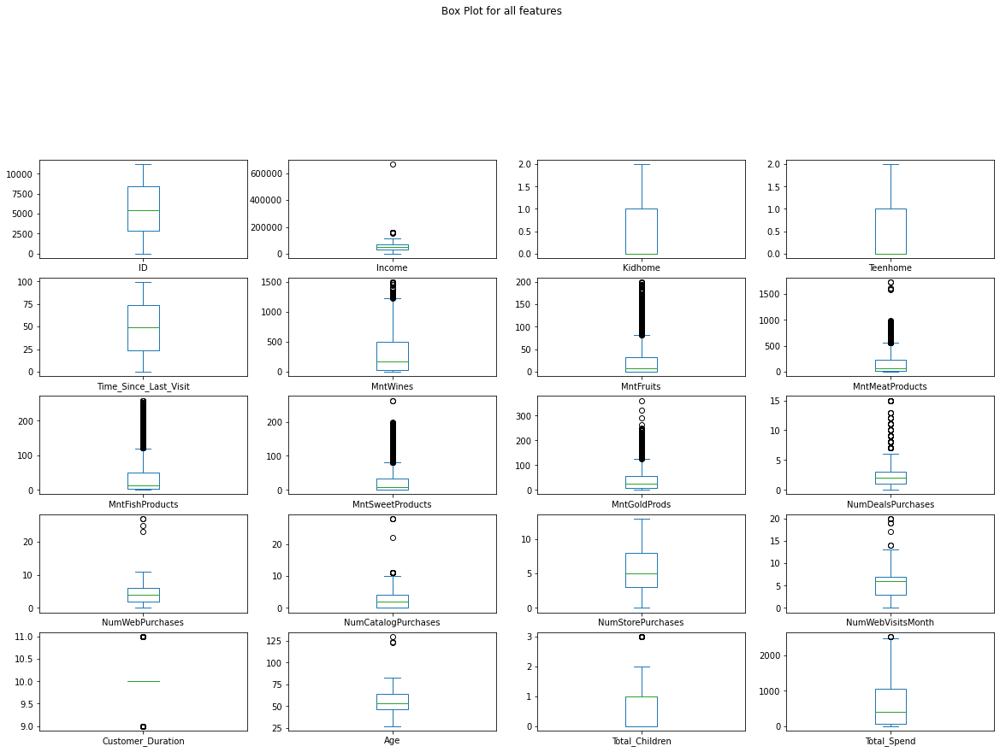

In [80]:
df.plot(kind='box', subplots=True, layout=(10,4), sharex=False, sharey=False, figsize=(20,25), 
              title='Box Plot for all features')
plt.show()

In [81]:
numerical = ['Income', 'Age', 'Total_Spend']

def detect_outliers(d):
  for i in d:
    Q3, Q1 = np.percentile(df[i], [75 ,25])
    IQR = Q3 - Q1

    ul = Q3+1.5*IQR
    ll = Q1-1.5*IQR

    outliers = df[i][(df[i] > ul) | (df[i] < ll)]
    print(f'*** {i} outlier points***', '\n', outliers, '\n')

In [82]:
detect_outliers(numerical)

*** Income outlier points*** 
 164     157243.0
617     162397.0
655     153924.0
687     160803.0
1300    157733.0
1653    157146.0
2132    156924.0
2233    666666.0
Name: Income, dtype: float64 

*** Age outlier points*** 
 192    123
239    130
339    124
Name: Age, dtype: int64 

*** Total_Spend outlier points*** 
 1179    2525
1492    2524
1572    2525
Name: Total_Spend, dtype: int64 



In [83]:
# remove outliers
df = df[(df['Age']<100)]
df = df[(df['Income']<600000)]

In [84]:
df.shape

(2232, 24)

In [85]:
df.describe()

,ID,Income,Kidhome,Teenhome,Time_Since_Last_Visit,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Customer_Duration,Age,Total_Children,Total_Spend
count,2232.000000,2232.000000,2232.000000,2232.000000,2232.000000,2232.000000,2232.000000,2232.000000,2232.000000,2232.000000,2232.000000,2232.000000,2232.000000,2232.000000,2232.000000,2232.000000,2232.000000,2232.000000,2232.000000,2232.000000
mean,5588.393817,51937.477599,0.444892,0.506720,49.154122,304.065412,26.244624,166.957885,37.415771,27.099014,43.841398,2.323925,4.085573,2.660394,5.794803,5.319892,9.971326,54.111111,0.951613,605.624104
std,3243.397549,21420.681136,0.538613,0.544686,28.949677,336.871724,39.711783,225.752900,54.456115,41.320001,51.872745,1.932849,2.781015,2.921548,3.253934,2.424993,0.684124,11.699288,0.752338,602.123276
min,0.000000,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9.000000,27.000000,0.000000,5.000000
25%,2828.250000,35434.750000,0.000000,0.000000,24.000000,24.000000,1.000000,16.000000,3.000000,1.000000,9.000000,1.000000,2.000000,0.000000,3.000000,3.000000,10.000000,46.000000,0.000000,69.000000
50%,5454.500000,51381.500000,0.000000,0.000000,49.500000,173.000000,8.000000,67.000000,12.000000,8.000000,24.000000,2.000000,4.000000,2.000000,5.000000,6.000000,10.000000,53.000000,1.000000,396.000000
75%,8421.750000,68275.750000,1.000000,1.000000,74.000000,505.000000,33.000000,232.000000,50.000000,33.000000,56.000000,3.000000,6.000000,4.000000,8.000000,7.000000,10.000000,64.000000,1.000000,1044.250000
max,11191.000000,162397.000000,2.000000,2.000000,99.000000,1493.000000,199.000000,1725.000000,259.000000,263.000000,362.000000,15.000000,27.000000,28.000000,13.000000,20.000000,11.000000,83.000000,3.000000,2525.000000


In [86]:
# drop ages of unusual value
df = df.drop(df.index[df['Age'].isin(['192','192','122','239','129','339','123'])])

In [87]:
# drop income that dont look believable
df = df[df.Income != '666666']

In [88]:
# re-Check for outliers
numerical = ['Income', 'Age', 'Total_Spend']

def detect_outliers(d):
  for i in d:
    Q3, Q1 = np.percentile(df[i], [75 ,25])
    IQR = Q3 - Q1

    ul = Q3+1.5*IQR
    ll = Q1-1.5*IQR

    outliers = df[i][(df[i] > ul) | (df[i] < ll)]
    print(f'*** {i} outlier points***', '\n', outliers, '\n')

In [89]:
detect_outliers(numerical)

*** Income outlier points*** 
 164     157243.0
617     162397.0
655     153924.0
687     160803.0
1300    157733.0
1653    157146.0
2132    156924.0
Name: Income, dtype: float64 

*** Age outlier points*** 
 Series([], Name: Age, dtype: int64) 

*** Total_Spend outlier points*** 
 1179    2525
1492    2524
1572    2525
Name: Total_Spend, dtype: int64 



### 3.7. Encoding

Will apply the following encoding for each categorical features:  

    - Eduction = Ordinal encoder (as it is ordinal variable)  
    - Age_Profile = Ordinal encoder (as it is ordinal variable)
    - Marital_Status = Dummy Encoder  
    - Cust_Profile = Label encoder (as it is our label for customer spend profile)  

In [90]:
from sklearn.preprocessing import LabelEncoder
from sklearn import preprocessing
from sklearn.preprocessing import OrdinalEncoder

In [91]:
enc = OrdinalEncoder()

In [92]:
df_enc = df

In [93]:
df_enc[["Education_enc"]] = enc.fit_transform(df[["Education"]])

In [94]:
df_enc[["Age_Profile_enc"]] = enc.fit_transform(df[["Age_Profile"]])

In [95]:
df_enc = pd.get_dummies(df, columns=["Marital_Status"])

In [96]:
label = df[['Cust_Profile']]

In [97]:
label_encoder = preprocessing.LabelEncoder()
  
# Encode labels in column 'Cust_Profile'.
df_enc['Cust_Profile']= label_encoder.fit_transform(df['Cust_Profile'])
  
df_enc['Cust_Profile'].unique()

array([1, 2, 0])

In [98]:
df_enc.drop(columns=["Education", "Age_Profile"], inplace=True)

In [99]:
df_enc.head()

,ID,Income,Kidhome,Teenhome,Time_Since_Last_Visit,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,...,Total_Spend,Cust_Profile,Education_enc,Age_Profile_enc,Marital_Status_Alone,Marital_Status_Divorced,Marital_Status_Married,Marital_Status_Single,Marital_Status_Together,Marital_Status_Widow
0,5524,58138.0,0,0,58,635,88,546,172,88,...,1617,1,2.0,0.0,0,0,0,1,0,0
1,2174,46344.0,1,1,38,11,1,6,2,1,...,27,2,2.0,0.0,0,0,0,1,0,0
2,4141,71613.0,0,0,26,426,49,127,111,21,...,776,0,2.0,0.0,0,0,0,0,1,0
3,6182,26646.0,1,0,26,11,4,20,10,3,...,53,2,2.0,1.0,0,0,0,0,1,0
4,5324,58293.0,1,0,94,173,43,118,46,27,...,422,0,4.0,1.0,0,0,1,0,0,0


**After encoding we have all categorical features transformed into numeric.**

In [100]:
df_enc.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2232 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   ID                       2232 non-null   int64  
 1   Income                   2232 non-null   float64
 2   Kidhome                  2232 non-null   int64  
 3   Teenhome                 2232 non-null   int64  
 4   Time_Since_Last_Visit    2232 non-null   int64  
 5   MntWines                 2232 non-null   int64  
 6   MntFruits                2232 non-null   int64  
 7   MntMeatProducts          2232 non-null   int64  
 8   MntFishProducts          2232 non-null   int64  
 9   MntSweetProducts         2232 non-null   int64  
 10  MntGoldProds             2232 non-null   int64  
 11  NumDealsPurchases        2232 non-null   int64  
 12  NumWebPurchases          2232 non-null   int64  
 13  NumCatalogPurchases      2232 non-null   int64  
 14  NumStorePurchases       

Before scaling I will drop columns ID, Cust_Profile and Age_Profile as they will not add value to the clustering model, ID is a unique identifier, Cust_Profile will be captured in the Total_Spend column and Age_Profile will be captured in the Age feature.

by looking at the heatmap we can see that the columns ID and Time_Since_Last_Visit have a low correlation with the other features, and the columns "Kidhome" and "Teenhome" are duplicated with the column "Total_Children" so before passing through the model I will drop these columns.

In [101]:
# This code drops certain columns from the 'df_enc' DataFrame, including 'ID', 'Time_Since_Last_Visit', 'Kidhome', and 'Teenhome'.
df_enc.drop(['ID','Time_Since_Last_Visit', 'Kidhome', 'Teenhome'], axis = 1, inplace=True)

In [102]:
df_enc.head()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,...,Total_Spend,Cust_Profile,Education_enc,Age_Profile_enc,Marital_Status_Alone,Marital_Status_Divorced,Marital_Status_Married,Marital_Status_Single,Marital_Status_Together,Marital_Status_Widow
0,58138.0,635,88,546,172,88,88,3,8,10,...,1617,1,2.0,0.0,0,0,0,1,0,0
1,46344.0,11,1,6,2,1,6,2,1,1,...,27,2,2.0,0.0,0,0,0,1,0,0
2,71613.0,426,49,127,111,21,42,1,8,2,...,776,0,2.0,0.0,0,0,0,0,1,0
3,26646.0,11,4,20,10,3,5,2,2,0,...,53,2,2.0,1.0,0,0,0,0,1,0
4,58293.0,173,43,118,46,27,15,5,5,3,...,422,0,4.0,1.0,0,0,1,0,0,0


### 3.8. Scaling

**"It is important to scale the data as many machine learning algorithms learn by calculating the distance between the data points to make better inferences out of the data."**

**Reference:**  

Verma, Y. (2021). Why Data Scaling is important in Machine Learning & How to effectively do it. [online] Analytics India Magazine. Available at: https://analyticsindiamag.com/why-data-scaling-is-important-in-machine-learning-how-to-effectively-do-it/.

As previously seen from EDA, the data does not follow a gaussian distribution and therefore we are going to apply Normalization aka Min-Max Scaler.

In [103]:
from sklearn.preprocessing import MinMaxScaler
# a MinMaxScaler object, which is used for feature scaling.
scaler = MinMaxScaler()
# The scaler is fit on the data and then applied to transform it so that the minimum value in each column is 0 and the maximum value is 1
scaled_df = scaler.fit_transform(df_enc)
scaled_df

array([[0.35108641, 0.42531815, 0.44221106, ..., 1.        , 0.        ,
        0.        ],
       [0.27767992, 0.00736772, 0.00502513, ..., 1.        , 0.        ,
        0.        ],
       [0.43495553, 0.28533155, 0.24623116, ..., 0.        , 1.        ,
        0.        ],
       ...,
       [0.34388518, 0.60817147, 0.24120603, ..., 0.        , 0.        ,
        0.        ],
       [0.42021697, 0.28667113, 0.15075377, ..., 0.        , 1.        ,
        0.        ],
       [0.31829187, 0.05626256, 0.01507538, ..., 0.        , 0.        ,
        0.        ]])

In [104]:
# Create a new pandas dataframe called "scaled_df" from the scaled data, with column names from the original dataframe "df_enc"
scaled_df = pd.DataFrame(scaled_df, columns=df_enc.columns)
scaled_df.head()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,...,Total_Spend,Cust_Profile,Education_enc,Age_Profile_enc,Marital_Status_Alone,Marital_Status_Divorced,Marital_Status_Married,Marital_Status_Single,Marital_Status_Together,Marital_Status_Widow
0,0.351086,0.425318,0.442211,0.316522,0.664093,0.334601,0.243094,0.200000,0.296296,0.357143,...,0.639683,0.5,0.5,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,0.277680,0.007368,0.005025,0.003478,0.007722,0.003802,0.016575,0.133333,0.037037,0.035714,...,0.008730,1.0,0.5,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,0.434956,0.285332,0.246231,0.073623,0.428571,0.079848,0.116022,0.066667,0.296296,0.071429,...,0.305952,0.0,0.5,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,0.155079,0.007368,0.020101,0.011594,0.038610,0.011407,0.013812,0.133333,0.074074,0.000000,...,0.019048,1.0,0.5,0.5,0.0,0.0,0.0,0.0,1.0,0.0
4,0.352051,0.115874,0.216080,0.068406,0.177606,0.102662,0.041436,0.333333,0.185185,0.107143,...,0.165476,0.0,1.0,0.5,0.0,0.0,1.0,0.0,0.0,0.0


In [105]:
scaled_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2232 entries, 0 to 2231
Data columns (total 25 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Income                   2232 non-null   float64
 1   MntWines                 2232 non-null   float64
 2   MntFruits                2232 non-null   float64
 3   MntMeatProducts          2232 non-null   float64
 4   MntFishProducts          2232 non-null   float64
 5   MntSweetProducts         2232 non-null   float64
 6   MntGoldProds             2232 non-null   float64
 7   NumDealsPurchases        2232 non-null   float64
 8   NumWebPurchases          2232 non-null   float64
 9   NumCatalogPurchases      2232 non-null   float64
 10  NumStorePurchases        2232 non-null   float64
 11  NumWebVisitsMonth        2232 non-null   float64
 12  Customer_Duration        2232 non-null   float64
 13  Age                      2232 non-null   float64
 14  Total_Children          

## 4. Modeling

### Identifying Cluster Numbers

### Finding the optimal number of clusters using the Elbow method

One way of measurement is <b>Within Cluster Sum of Squares (WCSS)</b>, which measures the squared average distance of all the points within a cluster to the cluster centroid. To calculate WCSS, you first find the Euclidean distance between a given point and the centroid to which it is assigned.

I will store my df into a new dataframe before applying clustering.

In [106]:
df_kmeans = df_enc

In [107]:
import plotly.graph_objects as go
from sklearn.cluster import KMeans

# Elbow method to determine the optimum number of Clusters
def elbow(df_enc, l_range, h_range):
    distortions = []
    for i in range(l_range, h_range):
        kms = KMeans(
            n_clusters=i,
            n_init=10, max_iter=300, random_state=0
        )
        kms.fit(df_kmeans)
        distortions.append(kms.inertia_)

    # Create the trace for the distortion vs. number of clusters
    trace = go.Scatter(
        x=list(range(l_range, h_range)),
        y=distortions,
        mode='lines+markers',
        name='Distortion'
    )

    # Create the layout for the plot
    layout = go.Layout(
        title={
        'text': "Distortion vs. Number of Clusters",
        'x': 0.5,
        'xanchor': 'center'
    },
        xaxis=dict(title='Number of clusters'),
        yaxis=dict(title='Distortion')
    )

    # Combine the trace and layout and create the figure
    fig = go.Figure(data=[trace], layout=layout)

    # Show the plot
    fig.show()


# Example usage
elbow(df_kmeans, 2, 11)

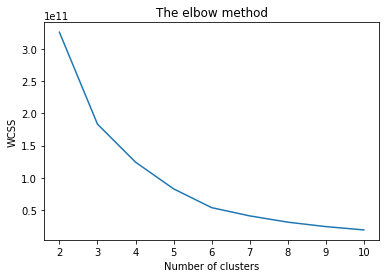

In [108]:
# Finding the optimum number of clusters for k-means classification
from sklearn.cluster import KMeans
wcss = []                  # Declare an array

# Set the loop from the minimum and maximum values
for i in range(2, 11):
    kmeans = KMeans(n_clusters = i, max_iter = 300, n_init = 10, random_state = 0)
                                                                                    
    kmeans.fit(df_kmeans)                                                                   
    wcss.append(kmeans.inertia_)                                                    
# inertia_float: Sum of squared distances of samples to their closest cluster center.

# Plotting the results onto a line graph, allowing us to observe 'The elbow'
plt.plot(range(2, 11), wcss)
plt.title('The elbow method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')    # within cluster sum of squares
plt.show()

From the graph above we can observe that the elbow occurs between 3 and 5 clusters and therefore I will select 4 clusters to start and test the model.

### Dimensionality Reduction

#### t-SNE

Like PCA, t-SNE takes high-dimensional data and converts it into a low-dimensional graph (usually two-dimensional). It's also a great technique for reducing dimensionality. Unlike PCA, t-SNE can be scaled down using nonlinear relationships. 

In [109]:
# Import the TSNE class from the sklearn.manifold module
from sklearn.manifold import TSNE

# Instantiate a TSNE object with 2 components, a perplexity of 30, 250 iterations and a learning rate of 200
tsne = TSNE(n_components=2, verbose=1, perplexity=30, n_iter=250, learning_rate=200)

# Fit and transform the scaled dataframe to the new 2D space using the TSNE object
tsne_scale_results = tsne.fit_transform(scaled_df)

# Create a new dataframe with the TSNE results, assigning the new 2D components to columns 'tsne1' and 'tsne2'
tsne_df = pd.DataFrame(tsne_scale_results, columns=['tsne1', 'tsne2'])

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2232 samples in 0.000s...
[t-SNE] Computed neighbors for 2232 samples in 0.073s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2232
[t-SNE] Computed conditional probabilities for sample 2000 / 2232
[t-SNE] Computed conditional probabilities for sample 2232 / 2232
[t-SNE] Mean sigma: 0.335792
[t-SNE] KL divergence after 250 iterations with early exaggeration: 58.911819
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000


### ML1.1. Clustering using KMeans - w/o scaling

One way of measurement is <b>Within Cluster Sum of Squares (WCSS)</b>, which measures the squared average distance of all the points within a cluster to the cluster centroid. To calculate WCSS, you first find the Euclidean distance between a given point and the centroid to which it is assigned.

In [110]:
# Applying KMeans to the dataset/ Creating the kmeans classifier
kmeans = KMeans(n_clusters = 4, max_iter = 300, n_init = 10, random_state = 38)

# n_initint, default = 10, Number of time the k-means algorithm will be run with different centroid seeds. 
# The final results will be the best output of n_init consecutive runs in terms of inertia.
y_kmeans = kmeans.fit_predict(df_kmeans)

In [111]:
y_kmeans

array([2, 0, 2, ..., 2, 2, 0])

## Clusters visualization and interpretation

As the features that most correlate in the dataset are Income and Total_Spend I will plot the clusters based on these two features.

In [112]:
# Create a trace for each cluster
trace0 = go.Scatter(
    x = df_kmeans[y_kmeans == 0].Total_Spend,
    y = df_kmeans[y_kmeans == 0].Income,
    mode = 'markers',
    marker = dict(
        size = 10,
        color = 'tomato'
    ),
    name = '0'
)

trace1 = go.Scatter(
    x = df_kmeans[y_kmeans == 1].Total_Spend,
    y = df_kmeans[y_kmeans == 1].Income,
    mode = 'markers',
    marker = dict(
        size = 10,
        color = 'mediumslateblue'
    ),
    name = '1'
)

trace2 = go.Scatter(
    x = df_kmeans[y_kmeans == 2].Total_Spend,
    y = df_kmeans[y_kmeans == 2].Income,
    mode = 'markers',
    marker = dict(
        size = 10,
        color = 'lightseagreen'
    ),
    name = '2'
)

trace3 = go.Scatter(
    x = df_kmeans[y_kmeans == 3].Total_Spend,
    y = df_kmeans[y_kmeans == 3].Income,
    mode = 'markers',
    marker = dict(
        size = 10,
        color = 'darkgrey'
    ),
    name = '3'
)

# Combine the traces into a data list
data = [trace0, trace1, trace2, trace3]

# Define layout options for the plot
layout = dict(
    title = {
        'text': "K-means clustering results",
        'x': 0.5,
        'xanchor': 'center'
    },
    xaxis = dict(title = 'Total_Spend'),
    yaxis = dict(title = 'Income'),
    legend = dict(
        x = 0.9,
        y = 1,
        traceorder = 'normal',
        font = dict(
            family = 'sans-serif',
            size = 12,
            color = '#000'
        ),
        bgcolor = '#E2E2E2',
        bordercolor = '#FFFFFF',
        borderwidth = 2
    )
)

# Create the figure object
fig = go.Figure(data=data, layout=layout)

# Display the plot
fig.show()

We will also visualize the clusters based on the Age vs the Total Spend.

In [113]:
# Create a trace for each cluster
trace0 = go.Scatter(
    x = df_kmeans[y_kmeans == 0].Total_Spend,
    y = df_kmeans[y_kmeans == 0].Age,
    mode = 'markers',
    marker = dict(
        size = 10,
        color = 'tomato'
    ),
    name = '0'
)

trace1 = go.Scatter(
    x = df_kmeans[y_kmeans == 1].Total_Spend,
    y = df_kmeans[y_kmeans == 1].Age,
    mode = 'markers',
    marker = dict(
        size = 10,
        color = 'mediumslateblue'
    ),
    name = '1'
)

trace2 = go.Scatter(
    x = df_kmeans[y_kmeans == 2].Total_Spend,
    y = df_kmeans[y_kmeans == 2].Age,
    mode = 'markers',
    marker = dict(
        size = 10,
        color = 'lightseagreen'
    ),
    name = '2'
)

trace3 = go.Scatter(
    x = df_kmeans[y_kmeans == 3].Total_Spend,
    y = df_kmeans[y_kmeans == 3].Age,
    mode = 'markers',
    marker = dict(
        size = 10,
        color = 'darkgrey'
    ),
    name = '3'
)

# Combine the traces into a data list
data = [trace0, trace1, trace2, trace3]

# Define layout options for the plot
layout = dict(
    title = {
        'text': "K-means clustering results",
        'x': 0.5,
        'xanchor': 'center'
    },
    xaxis = dict(title = 'Total_Spend'),
    yaxis = dict(title = 'Age'),
    legend = dict(
        x = 0.9,
        y = 1,
        traceorder = 'normal',
        font = dict(
            family = 'sans-serif',
            size = 12,
            color = '#000'
        ),
        bgcolor = '#E2E2E2',
        bordercolor = '#FFFFFF',
        borderwidth = 2
    )
)

# Create the figure object
fig = go.Figure(data=data, layout=layout)

# Display the plot
fig.show()

In [114]:
# import silhouette score from sklearn library
from sklearn.metrics import silhouette_score

# Display the silhouette score values
print(f'Silhouette Score(n = 4): {silhouette_score(df_kmeans, y_kmeans)}')

Silhouette Score(n = 4): 0.5234012868826596


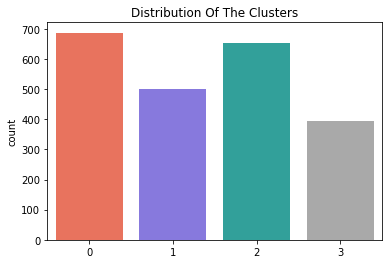

In [115]:
#Plotting countplot of clusters
pl = sns.countplot(y_kmeans, palette=['tomato', 'mediumslateblue', 'lightseagreen', 'darkgrey'])
pl.set_title("Distribution Of The Clusters")
plt.show()

### ML1.2. Clustering using KMeans - w/ scaling and dimensionality reduction

In [116]:
df_kmeans2 = scaled_df

In [117]:
# Elbow method to determine the optimum number of Clusters
def elbow(df_enc, l_range, h_range):
    distortions = []
    for i in range(l_range, h_range):
        kms = KMeans(
            n_clusters=i,
            n_init=10, max_iter=300, random_state=0
        )
        kms.fit(df_kmeans2)
        distortions.append(kms.inertia_)

    # Create the trace for the distortion vs. number of clusters
    trace = go.Scatter(
        x=list(range(l_range, h_range)),
        y=distortions,
        mode='lines+markers',
        name='Distortion'
    )

    # Create the layout for the plot
    layout = go.Layout(
        title={
        'text': "Distortion vs. Number of Clusters",
        'x': 0.5,
        'xanchor': 'center'
    },
        xaxis=dict(title='Number of clusters'),
        yaxis=dict(title='Distortion')
    )

    # Combine the trace and layout and create the figure
    fig = go.Figure(data=[trace], layout=layout)

    # Show the plot
    fig.show()


# Example usage
elbow(df_kmeans2, 2, 11)

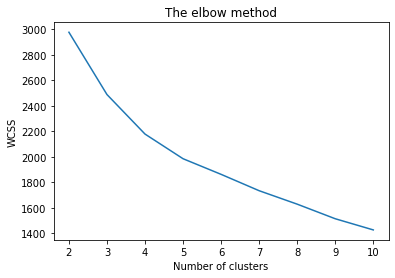

In [118]:
# Finding the optimum number of clusters for k-means classification
from sklearn.cluster import KMeans
wcss = []                  # Declare an array

# Set the loop from the minimum and maximum values
for i in range(2, 11):
    kmeans = KMeans(n_clusters = i, max_iter = 300, n_init = 10, random_state = 0)
                                                                                    
    kmeans.fit(df_kmeans2)                                                                   
    wcss.append(kmeans.inertia_)                                                    
# inertia_float: Sum of squared distances of samples to their closest cluster center.

# Plotting the results onto a line graph, allowing us to observe 'The elbow'
plt.plot(range(2, 11), wcss)
plt.title('The elbow method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')    # within cluster sum of squares
plt.show()

In [119]:
# Applying KMeans to the dataset/ Creating the kmeans classifier
kmeans2 = KMeans(n_clusters = 4, max_iter = 300, n_init = 10, random_state = 38)

# n_initint, default = 10, Number of time the k-means algorithm will be run with different centroid seeds. 
# The final results will be the best output of n_init consecutive runs in terms of inertia.
y_kmeans2 = kmeans.fit_predict(df_kmeans2)

In [120]:
# Create a trace for each cluster
trace0 = go.Scatter(
    x = df_kmeans[y_kmeans2 == 0].Total_Spend,
    y = df_kmeans[y_kmeans2 == 0].Income,
    mode = 'markers',
    marker = dict(
        size = 10,
        color = 'tomato'
    ),
    name = '0'
)

trace1 = go.Scatter(
    x = df_kmeans[y_kmeans2 == 1].Total_Spend,
    y = df_kmeans[y_kmeans2 == 1].Income,
    mode = 'markers',
    marker = dict(
        size = 10,
        color = 'mediumslateblue'
    ),
    name = '1'
)

trace2 = go.Scatter(
    x = df_kmeans[y_kmeans2 == 2].Total_Spend,
    y = df_kmeans[y_kmeans2 == 2].Income,
    mode = 'markers',
    marker = dict(
        size = 10,
        color = 'lightseagreen'
    ),
    name = '2'
)

trace3 = go.Scatter(
    x = df_kmeans[y_kmeans2 == 3].Total_Spend,
    y = df_kmeans[y_kmeans2 == 3].Income,
    mode = 'markers',
    marker = dict(
        size = 10,
        color = 'darkgrey'
    ),
    name = '3'
)

# Combine the traces into a data list
data = [trace0, trace1, trace2, trace3]

# Define layout options for the plot
layout = dict(
    title = {
        'text': "K-means clustering results after scaling",
        'x': 0.5,
        'xanchor': 'center'
    },
    xaxis = dict(title = 'Total_Spend'),
    yaxis = dict(title = 'Income'),
    legend = dict(
        x = 0.9,
        y = 1,
        traceorder = 'normal',
        font = dict(
            family = 'sans-serif',
            size = 12,
            color = '#000'
        ),
        bgcolor = '#E2E2E2',
        bordercolor = '#FFFFFF',
        borderwidth = 2
    )
)

# Create the figure object
fig = go.Figure(data=data, layout=layout)

# Display the plot
fig.show()

In [121]:
# Create a trace for each cluster
trace0 = go.Scatter(
    x = df_kmeans[y_kmeans2 == 0].Total_Spend,
    y = df_kmeans[y_kmeans2 == 0].Age,
    mode = 'markers',
    marker = dict(
        size = 10,
        color = 'tomato'
    ),
    name = '0'
)

trace1 = go.Scatter(
    x = df_kmeans[y_kmeans2 == 1].Total_Spend,
    y = df_kmeans[y_kmeans2 == 1].Age,
    mode = 'markers',
    marker = dict(
        size = 10,
        color = 'mediumslateblue'
    ),
    name = '1'
)

trace2 = go.Scatter(
    x = df_kmeans[y_kmeans2 == 2].Total_Spend,
    y = df_kmeans[y_kmeans2 == 2].Age,
    mode = 'markers',
    marker = dict(
        size = 10,
        color = 'lightseagreen'
    ),
    name = '2'
)

trace3 = go.Scatter(
    x = df_kmeans[y_kmeans2 == 3].Total_Spend,
    y = df_kmeans[y_kmeans2 == 3].Age,
    mode = 'markers',
    marker = dict(
        size = 10,
        color = 'darkgrey'
    ),
    name = '3'
)

# Combine the traces into a data list
data = [trace0, trace1, trace2, trace3]

# Define layout options for the plot
layout = dict(
    title = {
        'text': "K-means clustering results",
        'x': 0.5,
        'xanchor': 'center'
    },
    xaxis = dict(title = 'Total_Spend'),
    yaxis = dict(title = 'Age'),
    legend = dict(
        x = 0.9,
        y = 1,
        traceorder = 'normal',
        font = dict(
            family = 'sans-serif',
            size = 12,
            color = '#000'
        ),
        bgcolor = '#E2E2E2',
        bordercolor = '#FFFFFF',
        borderwidth = 2
    )
)

# Create the figure object
fig = go.Figure(data=data, layout=layout)

# Display the plot
fig.show()

In [122]:
# import silhouette score from sklearn library
from sklearn.metrics import silhouette_score

# Display the silhouette score values
print(f'Silhouette Score(n = 4): {silhouette_score(df_kmeans2, y_kmeans2)}')

Silhouette Score(n = 4): 0.2630244177810765


The algorithm worked better in the Data without scaling, being able to separate clearer clusters and with a higher Silhouette Score. Therefore we will focus on developing the algorithm using the dataset with no scaling.

In [123]:
# assigning a columns with clusters labels to the data frame
df_kmeans['cluster'] = y_kmeans

### ML2. Hierarchical Clustering

Agglomerative clustering is a special type of hierarchical clustering. The metric used to merge clusters is  distance, i.e. H. It merges the closest pair of clusters based on the distance between the centroids and repeats this step until only one cluster remains. A proximity matrix is ​​used for this purpose. This matrix stores the distances between each point.  

1. Every point is stored in its own cluster  
2. The proximity Matrix is calculated  
3. Closest points are detected and merged. They are the cluster and centroid is calculated.  
4. The proximity matrix is updated using the centroid of the created cluster.  
5. Steps 3 and 4 are repeated until one cluster is created. 

In [124]:
import scipy.cluster.hierarchy as sch
#Importing Libraries
from scipy.cluster.hierarchy import linkage
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import cut_tree 

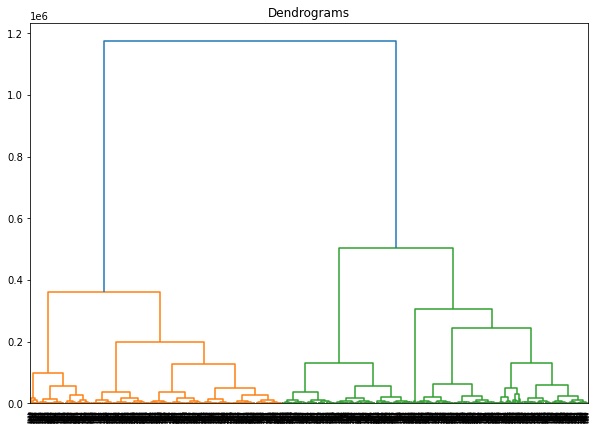

In [125]:
# Create a figure with the specified size and title
plt.figure(figsize=(10, 7))
plt.title("Dendrograms")

#Generate the dendrogram using the Ward method and store the result in a variable
dend = dendrogram(linkage(df_enc, method='ward'))

# Display the plot
plt.show()

What are we looking at?  
On the x-axis we have all the points in the dataset and on the y-axis we have the distances between those points. Each time points or clusters are combined, it is displayed as a horizontal line. The vertical line represents the distances between the merged points/clusters. Longer vertical lines on the dendrogram indicate that the distance between clusters is larger. In the next step we need to set the threshold distance and draw a horizontal line on this image. In general, we try to set the threshold so that it crosses the highest vertical line. In our example we set it to 15. Here's how it's done:

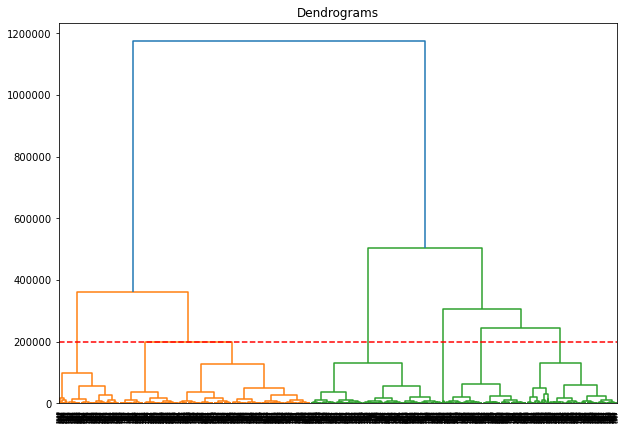

In [126]:
# Create fig size
plt.figure(figsize=(10, 7))

# Set the title of the plot
plt.title("Dendrograms")

# Generate the dendrogram using the Ward linkage method
dend = dendrogram(linkage(df_enc, method='ward'))

# Add a horizontal line at y=200000 to mark the cutoff for the number of clusters
plt.axhline(y=200000, color='r', linestyle='--')

# Format the y-axis tick labels as regular integers
plt.ticklabel_format(style='plain', axis='y')

# Show the plot
plt.show()

The number of clusters is determined by the number of vertical lines crossed by the threshold line. As we can see, the number of clusters in our example is 4.

In [127]:
#Initiating the Agglomerative Clustering model 
AC = AgglomerativeClustering(n_clusters=4)
# fit model and predict clusters
yhat_AC = AC.fit_predict(df_enc)
#Adding the Clusters feature to the orignal dataframe.
df["cluster_agglo"]= yhat_AC

In [128]:
# Silhoutte Score
sc= silhouette_score(df_enc, yhat_AC)
print (f"Silhoutte Score is: {sc}")

Silhoutte Score is: 0.4869045820961313


### ML3. DBSCAN

DBSCAN clustering (where DBSCAN is short for Density Based Noisy Application Spatial Clustering) involves finding high-density regions in a domain and expanding those feature-space regions around them as a cluster.   
It is implemented by the DBSCAN class, and the main configuration to set up is the "eps" and "min_samples" hyperparameters.

We define two hyperparameters for distance ε and the number of samples per cluster – n. The steps are:  

1. First, we assign a random sample x to the first cluster.  
2. We count how many samples have a distance from the sample x that is less or equal to ε. If the number of such samples is greater or equal to n, we add them in the cluster.  
3. We observe each new member of the cluster and perform step 2 for them too, ie. we calculate the number of samples within the ε area of the sample and if that number is larger then n, we add them to the cluster. We repeat this process recursively until there are no more samples left to put in it.  
4. Steps from 1 to 3 for a new random unclustered sample.  
5. The process is repeated like this until all samples are either clustered or marked as outliers.

The main benefit of this approach is that the clusters have a distinct and random shape. Algorithms based on centroids always produce clusters that have the shape of a hypersphere. Because of this, DBSCAN can be particularly useful for some data. The main problem, of course,  is choosing the optimal values ​​of ε and n.

In [129]:
# creating an object of the NearestNeighbors class
neighb = NearestNeighbors(n_neighbors=2)
# fitting the data to the object
nbrs=neighb.fit(tsne_df)
# finding the nearest neighbours
distances,indices=nbrs.kneighbors(tsne_df) 

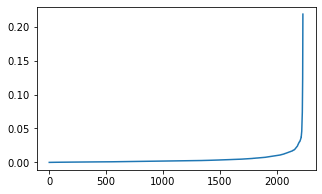

In [130]:
# Sort and plot the distances results
distances = np.sort(distances, axis = 0)
# taking the second column of the sorted distances
distances = distances[:, 1] 
# setting the figure size
plt.rcParams['figure.figsize'] = (5,3) 
# plotting the distances
plt.plot(distances) 
# showing the plot
plt.show() 

In [131]:
#Initiating the DBSCAN Clustering model 
DB = DBSCAN(eps=0.4, min_samples=250)
# fit model and predict clusters
DB_df = DB.fit_predict(tsne_df)
#Adding the Clusters feature to the orignal dataframe.
df["cluster_dbscan"]= DB_df

In [132]:
np.unique(DB_df)

array([-1,  0,  1,  2,  3], dtype=int64)

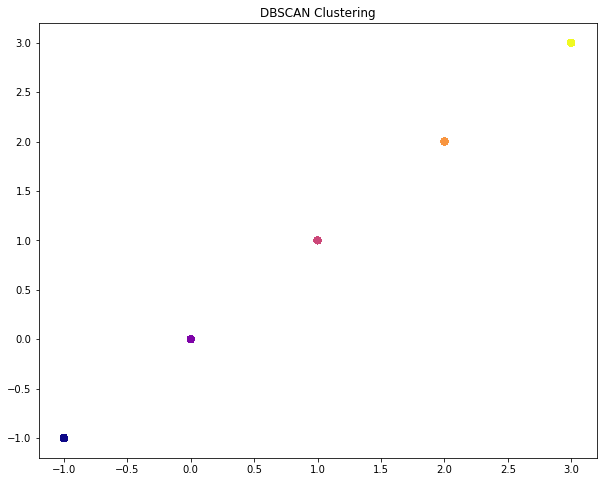

In [133]:
#Plotting the clusters
fig = plt.figure(figsize=(10,8))
plt.scatter(df["cluster_dbscan"], df["cluster_dbscan"], s=40, c= DB_df, marker='o', cmap = 'plasma' )
plt.title("DBSCAN Clustering")
plt.show()

In [134]:
# Silhoutte Score
sc= silhouette_score(tsne_df, DB_df)
print (f"Silhoutte Score is: {sc}")

Silhoutte Score is: 0.35817140340805054


## 5. Evaluation

|Evaluation Metric|K-means|Hierarchical|DBSCAN|
|---|---|---|---|
|Silhouette Coefficient|0.523|0.487|0.423|

**The algorithm with the best performance is K-means with dimensionality reduction.**

In [135]:
{
        'text': "Distribution of the Clusters",
        'x': 0.5,
        'xanchor': 'center'
    }

{'text': 'Distribution of the Clusters', 'x': 0.5, 'xanchor': 'center'}

In [136]:
# Count the number of instances in each cluster
cluster_counts = df_kmeans['cluster'].value_counts()

# Create a DataFrame from the cluster counts
cluster_counts_df = pd.DataFrame({'cluster': cluster_counts.index, 'count': cluster_counts.values})

# Create the bar chart using Plotly Express
fig = px.bar(cluster_counts_df, x='cluster', y='count', color='cluster')

# Update the layout of the chart
fig.update_layout(
    title={
        'text': "Distribution of the Clusters",
        'x': 0.5,
        'xanchor': 'center'
    },
    xaxis_title='Cluster',
    yaxis_title='Count'
)

# Show the chart
fig.show()

In [137]:
# Create a box plot using Plotly Express
fig = px.box(df_kmeans, x="cluster", y="Total_Spend", color="cluster", title="Cluster Profiles Based On Spending")

# Update the layout of the chart
fig.update_layout(xaxis_title='cluster', yaxis_title='Spending')

# Show the chart
fig.show()

In [138]:
# Create a box plot using Plotly Express
fig = px.box(df_kmeans, x="cluster", y="Income", color="cluster", title="Cluster Profiles Based On Income")

# Update the layout of the chart
fig.update_layout(xaxis_title='cluster', yaxis_title='Income')

# Show the chart
fig.show()

In [139]:
# Create the scatter plot using Plotly Express
fig = px.scatter(df_kmeans, x='Total_Spend', y='Income', color='cluster', hover_data=['cluster'])

# Update the layout of the chart
fig.update_layout(
title='Cluster Profiles Based On Income And Spending',
xaxis_title='Total Spend',
yaxis_title='Income'
)

# Show the chart
fig.show()

<u>**Cluster Spend caracteristcs:**</u>

- Cluster 0 is low /average spend;  
- Cluster 1 is low spend;  
- Cluster 2 is average / high;  
- Cluster 3 is High spend;  

Clusters could be classified as follows:  

    - Cluster 0 and 1 are customers that we want to retain and upsell;    
    - Cluster 2 are customers we want to focus on upsell through promotions and bring new customers;  
    - Cluster 3 we will look into what products they are not buying and create promotions around that and also use them to bring more customers;  

In [140]:
fig = px.box(df_kmeans, x='cluster', y='Income', title='Boxplot of Income by Cluster',
             color_discrete_sequence=px.colors.sequential.Bluered, points='all')

fig.update_traces(marker=dict(color='#c70610'), marker_line_color='#06c736', opacity=0.6)
fig.update_xaxes(title_text='Cluster')

fig.show()

<u>**Cluster Income caracteristcs:**</u>

- Cluster 0 is low /average Income;  
- Cluster 1 is low Income;  
- Cluster 2 is average / high;  
- Cluster 3 is High Income;  

In [141]:
# Group the data by cluster and customer profile and count the number of occurrences
df_count = df_kmeans.groupby(['cluster', 'Cust_Profile']).size().reset_index(name='count')

# Create the bar plot
fig = px.bar(df_count, x='cluster', y='count', color='Cust_Profile', 
             title='Count of Customer Profiles by Cluster')

# Set the legend location
fig.update_layout(legend=dict(yanchor="top", y=0.99, xanchor="left", x=0.01))

# Set the x and y-axis labels
fig.update_xaxes(title_text='Cluster')
fig.update_yaxes(title_text='Count')

fig.show()

**Visualizing the age profile in each cluster**

In [142]:
fig = px.histogram(df_kmeans, x='Age', color='cluster', nbins=20,
                   title='Age distribution by Cluster')
fig.update_layout(xaxis_title='Age', yaxis_title='Count')
fig.show()

In [143]:
fig = px.box(df_kmeans, x='cluster', y='Age', title='Boxplot of Age by Cluster', 
             color_discrete_sequence=['#1f77b4'])
fig.update_traces(marker_line_color='#1f77b4', opacity=0.6)
fig.update_xaxes(title_text='Cluster')
fig.show()

<u>**Cluster Age caracteristcs:**</u>

- Cluster 0 average age between 50 and 55 years old;  
- Cluster 1 are younger customers with its average at 49 years old;  
- Cluster 2 are older customers with the average between 55 and 60 years old;  
- Cluster 3 are average age customers between 50 and 55 years old;

In [144]:
df['cluster'] = y_kmeans

In [145]:
fig = px.histogram(df, x='cluster', color='Age_Profile',
                   barmode='group', nbins=len(df['cluster'].unique()))
fig.update_layout(title='Clusters by Age Profile', xaxis_title='Cluster', yaxis_title='Count')
fig.show()

In this chart we can see that cluster 3 our high spend customers are well balanced between Gen X and Gen Y

**Education distribution in each cluster**

In [146]:
fig = px.histogram(df, x='cluster', color='Education',
                   title='Clusters by Education',
                   color_discrete_sequence=px.colors.qualitative.Light24)
fig.update_layout(barmode='group')
fig.update_xaxes(title_text='Education')
fig.update_yaxes(title_text='Count')
fig.show()

Education is similar distributed across all clusters with higher education on clusters 0 and 2, however we have to take into account that these two clusters are the biggest clusters so we can assume education is pretty flat across the different clusters with no differentiation.

**Marital status distribution in each cluster**

In [147]:
# create a histogram with 'Marital_Status' on the x-axis and 'Cluster' on the color axis
fig = px.histogram(df, x='cluster', color='Marital_Status', title='Clusters by Marital Status',
                   color_discrete_sequence=px.colors.qualitative.Pastel)

# update the layout to group the bars by cluster and add axis labels
fig.update_layout(barmode='group', xaxis_title='Marital Status', yaxis_title='Count')

# show the plot
fig.show()

Marital status is also not a diferentiator for the clusters

**Total children distribution in each cluster**

In [148]:
fig = px.box(df, x='cluster', y='Total_Children',
             title='Boxplot of Total Children by Cluster')
fig.update_traces(marker_color='#1f77b4', marker_line_color='#1f77b4', 
                  boxmean=True, opacity=0.6)
fig.update_xaxes(title_text='Cluster')
fig.show()

<u>**Cluster Number of children caracteristcs:**</u>

- Cluster 0 between 1 and 2 children;  
- Cluster 1 customers has in average 1 child;  
- Cluster 2 between 0 and 1 child;  
- Cluster 3 majority of customers does not have children;  

In [149]:
fig = px.box(df, x='cluster', y='Time_Since_Last_Visit',
             title='Boxplot of Time Since Last Visit by Cluster')
fig.update_traces(marker_color='#1f77b4', marker_line_color='#1f77b4', boxmean=True, opacity=0.6)
fig.update_xaxes(title_text='Cluster')
fig.show()

Time since last visit is very similar across the different clusters and therefore will not be included in the customer characteristcs segmentation

In [150]:
import matplotlib.ticker as ticker

# Create a new column Sales_Channel by combining the four sales columns
df['Sales_Channel'] = ''
df.loc[df['NumDealsPurchases']>0, 'Sales_Channel'] = 'Deals'
df.loc[df['NumWebPurchases']>0, 'Sales_Channel'] = 'Web'
df.loc[df['NumCatalogPurchases']>0, 'Sales_Channel'] = 'Catalog'
df.loc[df['NumStorePurchases']>0, 'Sales_Channel'] = 'Store'

# Group by Sales_Channel and calculate the total spend
sales_totals = df.groupby('Sales_Channel')['Total_Spend'].sum()/2

# Visualize the total spend for each sales channel
fig = px.bar(sales_totals.reset_index(), x='Sales_Channel', y='Total_Spend',
             title='Total Spend by Sales Channel',
             labels={'Sales_Channel': 'Sales Channel', 'Total_Spend': 'Total Spend'})

fig.update_layout(xaxis={'title': 'Sales Channel'}, yaxis={'title': 'Total Spend'})
fig.show()

Looking at the chart in Log Scale to be able to see the differences across sales channels

In [151]:
# Create a new column Sales_Channel by combining the four sales columns
df['Sales_Channel'] = ''
df.loc[df['NumDealsPurchases']>0, 'Sales_Channel'] = 'Deals'
df.loc[df['NumWebPurchases']>0, 'Sales_Channel'] = 'Web'
df.loc[df['NumCatalogPurchases']>0, 'Sales_Channel'] = 'Catalog'
df.loc[df['NumStorePurchases']>0, 'Sales_Channel'] = 'Store'

# Group by Sales_Channel and calculate the total spend
sales_totals = df.groupby('Sales_Channel', as_index=False)['Total_Spend'].sum()

# Visualize the total spend for each sales channel
fig = px.bar(sales_totals, x='Sales_Channel', y='Total_Spend',
             title='Total Spend by Sales Channel (log scale)',
             labels={'Sales_Channel': 'Sales Channel', 'Total_Spend': 'Total Spend'})
fig.update_layout(xaxis={'title': 'Sales Channel'}, yaxis={'title': 'Total Spend (log scale)'})
fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5, opacity=0.6)
fig.show()


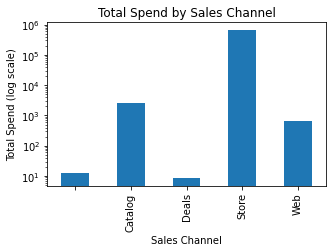

In [152]:
plt.gca().yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: '{:,.0f}'.format(x)))

# Create a new column Sales_Channel by combining the four sales columns
df['Sales_Channel'] = ''
df.loc[df['NumDealsPurchases']>0, 'Sales_Channel'] = 'Deals'
df.loc[df['NumWebPurchases']>0, 'Sales_Channel'] = 'Web'
df.loc[df['NumCatalogPurchases']>0, 'Sales_Channel'] = 'Catalog'
df.loc[df['NumStorePurchases']>0, 'Sales_Channel'] = 'Store'

# Group by Sales_Channel and calculate the total spend
sales_totals = df.groupby('Sales_Channel')['Total_Spend'].sum()/2

# Visualize the total spend for each sales channel
sales_totals.plot(kind='bar', xlabel='Sales Channel', ylabel='Total Spend')
plt.yscale('log')
plt.title('Total Spend by Sales Channel')
plt.xlabel('Sales Channel')
plt.ylabel('Total Spend (log scale)')  
plt.show()

Main Sales channel is Store.

**Cluster by Sales Channel**

In [153]:
# Create box plot of NumDealsPurchases by cluster
fig = px.box(df, x='cluster', y='NumDealsPurchases', title='NumDealsPurchases by Cluster')
fig.update_layout(xaxis={'title': 'Cluster'}, yaxis={'title': 'NumDealsPurchases'})
fig.show()

- Cluster 3 does not buy much through Deals (Promotions)  
- Clusters 0 to 2 are very similar in terms of buying through deals

In [154]:
fig = px.box(df, x='cluster', y='NumWebPurchases', title='Number of Web Purchases by Cluster')
fig.update_layout(xaxis={'title': 'Cluster'}, yaxis={'title': 'Number of Web Purchases'})
fig.show()

- Clusters 2 and 3 have a higher average on buying through the Web  
- Cluster 0 is a bit lower and cluster 1 is the lowest buying through the web  

In [155]:
fig = px.box(df, x='cluster', y='NumCatalogPurchases', title='Number of Catalog Purchases by Cluster',
             labels={'cluster': 'Cluster', 'NumCatalogPurchases': 'Number of Catalog Purchases'})
fig.update_layout(xaxis={'title': 'Cluster'}, yaxis={'title': 'Number of Catalog Purchases'})
fig.show()

- Cluster 3 is the highest average buying through Catalog followed by Cluter 2  
- Clusters 0 and 1 are very low on buying through Catalog 

In [156]:
fig = px.box(df, x='cluster', y='NumStorePurchases',
             labels={'cluster': 'Cluster', 'NumStorePurchases': 'Number of Store Purchases'},
             title='Number of Store Purchases by Cluster')
fig.show()

- Clusters 2 and 3 have a similar average on buying on Store being the highest clusters by far followed by Cluster 0 and Cluster 1

In [157]:
df['Sales_Channel'].unique()

array(['Store', 'Web', 'Catalog', '', 'Deals'], dtype=object)

In [158]:
df['Products'] = ''
df.loc[df['MntFruits']>0, 'Products'] = 'Fruits'
df.loc[df['MntMeatProducts']>0, 'Products'] = 'Meat'
df.loc[df['MntFishProducts']>0, 'Products'] = 'Fish'
df.loc[df['MntSweetProducts']>0, 'Products'] = 'Sweet'
df.loc[df['MntGoldProds']>0, 'Products'] = 'Gold'

products_totals = df.groupby('Products')['Total_Spend'].sum().sort_values()/2

# Create bar plot
fig = px.bar(x=products_totals.index, y=products_totals.values,
             labels={'x': 'Products', 'y': 'Total Spend'},
             title='Total Spend by Products')

fig.update_layout(xaxis={'title': 'Products'},
                  yaxis={'title': 'Total Spend'},
                  uniformtext_minsize=8,
                  uniformtext_mode='hide')

fig.show()

In [159]:
fig = px.bar(df, x='cluster', color='Products', title='Cluster by Products Spend', 
             labels={'cluster': 'Cluster', 'count': 'Count'}, 
             category_orders={'cluster': ['Cluster 1', 'Cluster 2', 'Cluster 3']})
fig.update_layout(legend=dict(title='Products', orientation='h', y=1.1, x=0.5, xanchor='center'),
                  yaxis_type='log')
fig.show()


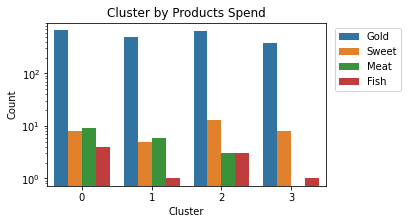

In [160]:
sns.countplot(x='cluster', hue='Products', data=df)
plt.legend(loc='upper center', bbox_to_anchor=(1.15, 1))
plt.title('Cluster by Products Spend')
plt.xlabel('Cluster')
plt.ylabel('Count')
plt.yscale('log')
plt.show()

The product that is most bought is Gold with a similar spend across the different clusters.
- Clusters 0, 1 and 2 spend on all products with Clusters 2 and 3 being the highest on Sweet purchases;  
- Cluster 3 does not buy Meat and is very low on buying Fish so there could be some campaings around increasing sales targeting these products to Cluster 3  

## 6. Deployment

### 6.1. Summary of Clusters Characteristics

<u>**Cluster 0:**</u>

**Frugal Families:** customers with moderate to low spending habits and average to low income, with 1-2 children and a preference for buying through the web.

   - Low/average spend
   - Low/average income
   - Average age between 50 and 55 years old
   - Between 1 and 2 children
   - Buys through deals, web, catalog, and store
   - Spends on all products, with a higher spend on Sweet purchases

<u>**Cluster 1:**</u>

**Young Savers:** younger customers with low income and low spending habits, with an average of 1 child and a preference for buying in-store.
 
   - Low spend
   - Low income
   - Average age at 49 years old
   - 1 child
   - Buys through deals, web, catalog, and store
   - Low spend on all products

<u>**Cluster 2:**</u>

**Comfortable Seniors:** older customers with average to high income and average to high spending habits, with 0-1 children and a preference for buying through promotions and the web.

   - Average/high spend
   - Average/high income
   - Older customers with the average between 55 and 60 years old
   - Between 0 and 1 child
   - Buys through deals, web, catalog, and store
   - Spends on all products, with a higher spend on Gold and Sweet products

<u>**Cluster 3:**</u>

**Affluent Singles:** high income customers with high spending habits, who do not have children and prefer buying through catalogs and Store.

   - High spend
   - High income
   - Average age between 50 and 55 years old
   - Majority of customers do not have children
   - Buys through web, catalog, and store but does not buy much through deals
   - Spends on all products except for Meat and is very low on buying Fish.

### 6.2. Marketing Strategy

#### Retain and upsell:

   - **Frugal Families** --> 
       - Upsell through online advertisement, promotions and discounts to encourage more spending in-store;  
       - Focus on campaings that highlight the value and affordability of products;
       - Offer family-friendly products and services, as the majority of this cluster has 1-2 children;  
         
   - **Young Savers** --> 
       - Offer discounts and promotions that appeal to budget-conscious customers, as this cluster has low income and spending habits.
       - Develop marketing campaigns that target younger customers and emphasize the convenience and experience of buying in-store.  
       - Consider offering products and services that cater to the needs and interests of young adults, such as technology, fashion, and entertainment.  
    
#### Acquisition, retain and upsell:

   - **Comfortable Seniors** --> 
       - Develop marketing campaigns that target older customers and emphasize the quality and reliability of products, as this cluster has average to high income and spending habits.  
       - Consider offering promotions and discounts that appeal to customers who prefer buying through the web and promotions.  
       - Offer products and services that cater to the needs and interests of seniors, such as health and wellness, travel, and leisure activities.  
   - **Affluent Singles** --> 
       - These are our best customers. Emphasize the exclusivity and luxury of products, as this cluster has high spending habits.
       - Create specific customer experience, customized products and services with benefits and a premium card with promotions and discounts;
       - Offer products and services that cater to the needs and interests of singles, such as fashion, beauty, and entertainment.
